In [1]:
import os
import pandas as pd
import numpy as np
import tensorflow as tf
import tensorflow_datasets as tfds

import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'


import warnings
warnings.filterwarnings('ignore')


## 데이터 불러오기

In [2]:
(raw_train, raw_validation, raw_test), metadata = tfds.load(
name='tf_flowers',
split=['train[:80%]', 'train[80%:90%]', 'train[90%:]'],
data_dir='~/aiffel/aiffel_quest/quest_240318/data/',
download=True,
with_info=True,
as_supervised=True,
)

In [3]:
metadata

tfds.core.DatasetInfo(
    name='tf_flowers',
    full_name='tf_flowers/3.0.1',
    description="""
    A large set of images of flowers
    """,
    homepage='https://www.tensorflow.org/tutorials/load_data/images',
    data_path='/aiffel/aiffel/aiffel_quest/quest_240318/data/tf_flowers/3.0.1',
    download_size=218.21 MiB,
    dataset_size=221.83 MiB,
    features=FeaturesDict({
        'image': Image(shape=(None, None, 3), dtype=tf.uint8),
        'label': ClassLabel(shape=(), dtype=tf.int64, num_classes=5),
    }),
    supervised_keys=('image', 'label'),
    disable_shuffling=False,
    splits={
        'train': <SplitInfo num_examples=3670, num_shards=2>,
    },
    citation="""@ONLINE {tfflowers,
    author = "The TensorFlow Team",
    title = "Flowers",
    month = "jan",
    year = "2019",
    url = "http://download.tensorflow.org/example_images/flower_photos.tgz" }""",
)

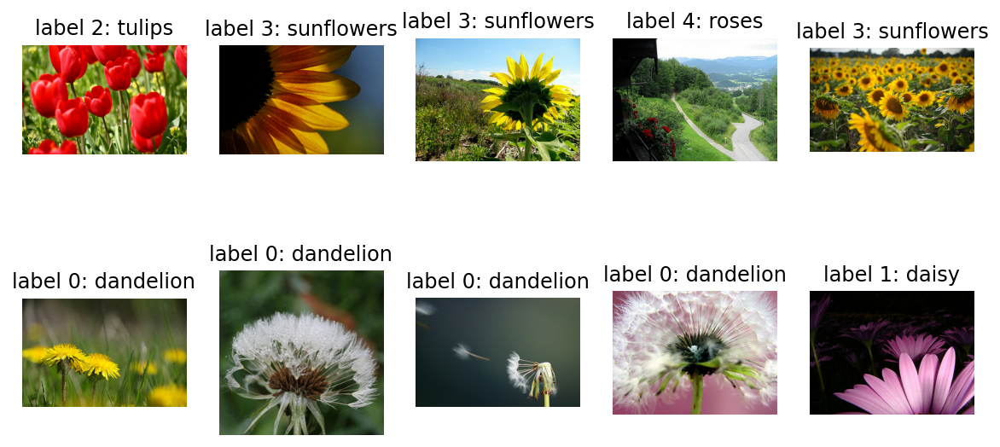

In [4]:
plt.figure(figsize=(10, 5))

get_label_name = metadata.features['label'].int2str

for idx, (image, label) in enumerate(raw_train.take(10)):  
    plt.subplot(2, 5, idx+1)
    plt.imshow(image)
    plt.title(f'label {label}: {get_label_name(label)}')
    plt.axis('off')

In [5]:
IMG_SIZE = 160
def format_example(image, label):
    image = tf.cast(image, tf.float32)
    image = (image/127.5) - 1
    image = tf.image.resize(image, ((IMG_SIZE, IMG_SIZE)))
    return image, label

In [6]:
train = raw_train.map(format_example)
validation = raw_validation.map(format_example)
test = raw_test.map(format_example)

print(train)
print(validation)
print(test)

<MapDataset shapes: ((160, 160, 3), ()), types: (tf.float32, tf.int64)>
<MapDataset shapes: ((160, 160, 3), ()), types: (tf.float32, tf.int64)>
<MapDataset shapes: ((160, 160, 3), ()), types: (tf.float32, tf.int64)>


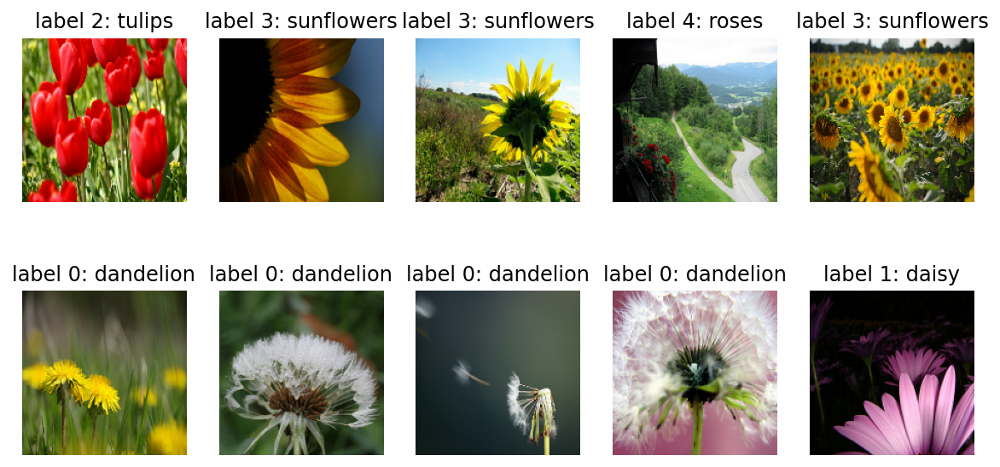

In [7]:
plt.figure(figsize=(10, 5))
plt.tight_layout()
for idx, (image, label) in enumerate(train.take(10)):
    plt.subplot(2, 5, idx+1)
    image = (image + 1) / 2
    plt.imshow(image)
    plt.title(f'label {label}: {get_label_name(label)}')
    plt.axis('off')

In [8]:
metadata.features['label'].num_classes

5

5개의 클래스가 있는 것을 확인

In [9]:
BATCH_SIZE=16
SHUFFLE_BUFFER_SIZE = 1000


train_batches = train.shuffle(SHUFFLE_BUFFER_SIZE).batch(BATCH_SIZE)
validation_batches = validation.batch(BATCH_SIZE)
test_batches = test.batch(BATCH_SIZE)

train_batches, validation_batches, test_batches 준비 완료

## 모델
- 우선 레이어를 직접 쌓아서 학습을 시도를 해보았다.

In [10]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy



input_layer=tf.keras.layers.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
# Block 1
x=tf.keras.layers.Conv2D(64, (3, 3), strides=1, activation='relu', padding='same')(input_layer)
x=tf.keras.layers.Conv2D(64, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.MaxPool2D((2, 2))(x)

# Block 2
x=tf.keras.layers.Conv2D(128, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.Conv2D(128, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.MaxPool2D((2, 2))(x)

# Block 3
x=tf.keras.layers.Conv2D(256, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.Conv2D(256, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.Conv2D(256, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.MaxPool2D((2, 2))(x)

# Block 4
x=tf.keras.layers.Conv2D(512, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.Conv2D(512, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.Conv2D(512, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.MaxPool2D((2, 2))(x)

# Block 5
x=tf.keras.layers.Conv2D(512, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.Conv2D(512, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.Conv2D(512, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.MaxPool2D((2, 2))(x)


x=tf.keras.layers.Flatten()(x)
x=tf.keras.layers.Dense(4096, activation='relu')(x)
x=tf.keras.layers.Dense(4096, activation='relu')(x)
x=tf.keras.layers.Dense(1000, activation='relu')(x)
x=tf.keras.layers.Dense(256, activation='relu')(x)
x=tf.keras.layers.Dropout(0.5)(x)
out_layer=tf.keras.layers.Dense(5, activation='softmax')(x)

model = tf.keras.Model(inputs=[input_layer], outputs=[out_layer])
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 160, 160, 3)]     0         
_________________________________________________________________
conv2d (Conv2D)              (None, 160, 160, 64)      1792      
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 160, 160, 64)      36928     
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 80, 80, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 80, 80, 128)       73856     
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 80, 80, 128)       147584    
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 40, 40, 128)       0     

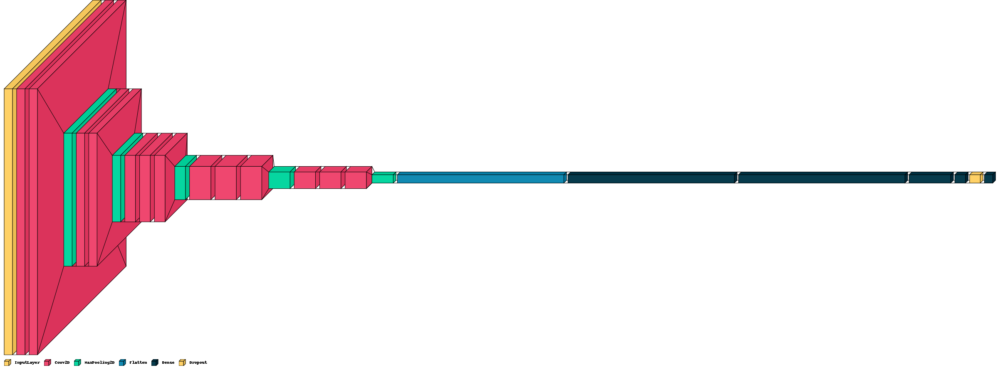

In [11]:
# !pip install visualkeras
import visualkeras

visualkeras.layered_view(model,legend=True)

모델의 구조를 확인을 해보았다.

In [12]:
learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=learning_rate),
             loss=tf.keras.losses.sparse_categorical_crossentropy,
             metrics=['accuracy'])


In [13]:
EPOCHS = 10
history = model.fit(train_batches,
                   epochs=EPOCHS,
                   validation_data=validation_batches)

Epoch 1/10
184/184 [==============================] - 42s 180ms/step - loss: 1.5728 - accuracy: 0.2701 - val_loss: 1.5271 - val_accuracy: 0.3542
Epoch 2/10
184/184 [==============================] - 28s 150ms/step - loss: 1.3300 - accuracy: 0.4084 - val_loss: 1.2107 - val_accuracy: 0.5313
Epoch 3/10
184/184 [==============================] - 28s 150ms/step - loss: 1.2221 - accuracy: 0.4642 - val_loss: 1.0856 - val_accuracy: 0.6022
Epoch 4/10
184/184 [==============================] - 28s 151ms/step - loss: 1.1529 - accuracy: 0.5215 - val_loss: 1.1419 - val_accuracy: 0.5504
Epoch 5/10
184/184 [==============================] - 28s 151ms/step - loss: 1.0552 - accuracy: 0.5971 - val_loss: 0.9697 - val_accuracy: 0.5886
Epoch 6/10
184/184 [==============================] - 28s 150ms/step - loss: 0.9826 - accuracy: 0.6284 - val_loss: 0.9642 - val_accuracy: 0.6376
Epoch 7/10
184/184 [==============================] - 28s 151ms/step - loss: 0.9185 - accuracy: 0.6686 - val_loss: 0.8392 - val_ac

In [14]:
# 모델 평가
evaluation = model.evaluate(validation_batches)

# 평가 결과 출력
print("Loss:", evaluation[0])
print("Accuracy:", evaluation[1])

23/23 [==============================] - 1s 37ms/step - loss: 0.9695 - accuracy: 0.6649
Loss: 0.9694671034812927
Accuracy: 0.664850115776062


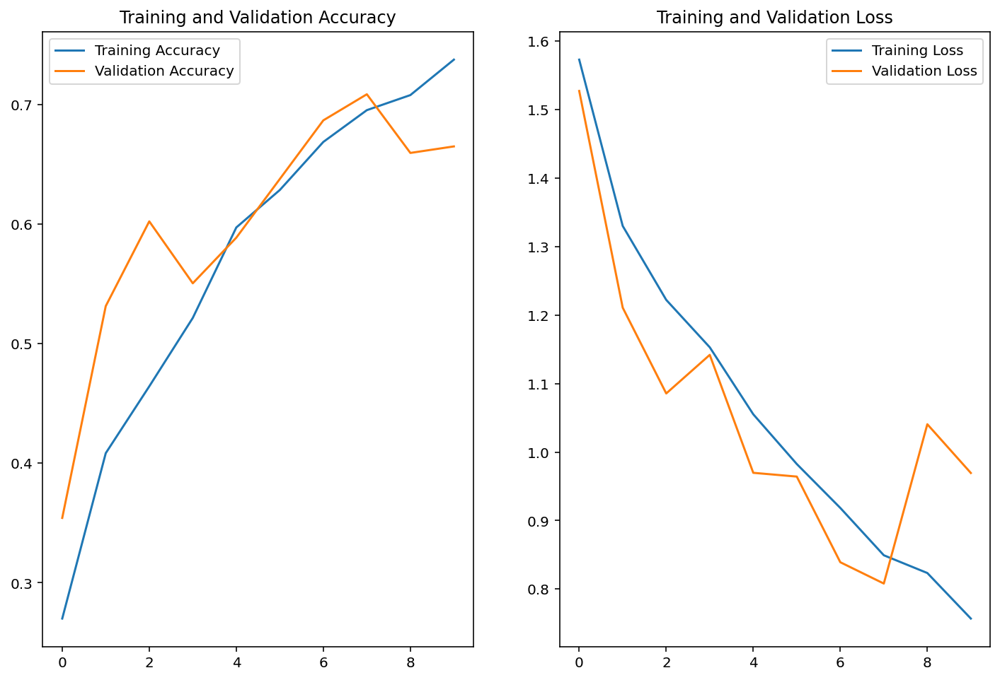

In [15]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(EPOCHS)

plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

In [19]:
for image_batch, label_batch in test_batches.take(1): #.take 첫 번째 배치를 가져오는 역할
        images = image_batch
        labels = label_batch
        predictions = model.predict(image_batch)
        break
        
predictions


array([[3.3582208e-05, 2.1981291e-04, 2.3042910e-01, 1.7005486e-04,
        7.6914746e-01],
       [9.9988556e-01, 8.5037966e-05, 5.5286550e-06, 5.9756781e-06,
        1.7842307e-05],
       [9.1357887e-01, 1.8139821e-02, 1.2830557e-02, 4.1060846e-02,
        1.4390002e-02],
       [3.6887296e-03, 8.7756841e-03, 2.6530838e-01, 5.1883697e-03,
        7.1703887e-01],
       [9.7765517e-01, 1.2691786e-02, 2.5798001e-03, 2.0846848e-03,
        4.9885097e-03],
       [1.1752353e-01, 1.2903044e-01, 2.2958955e-01, 3.9754800e-02,
        4.8410168e-01],
       [1.0624777e-04, 5.7391473e-04, 7.8182626e-01, 6.3042331e-04,
        2.1686320e-01],
       [7.8754656e-02, 7.6020397e-02, 3.1292441e-01, 3.7272148e-02,
        4.9502841e-01],
       [4.2836007e-02, 1.5096144e-03, 2.1076560e-02, 9.2805833e-01,
        6.5195384e-03],
       [9.9985027e-01, 1.0414192e-04, 8.5942902e-06, 1.1619150e-05,
        2.5243120e-05],
       [8.9348334e-01, 4.8667133e-02, 1.6223831e-02, 8.6219152e-03,
        3.30

In [20]:
predictions = np.argmax(predictions, axis=1)
predictions

array([4, 0, 0, 4, 0, 4, 2, 4, 3, 0, 0, 2, 3, 4, 0, 3])

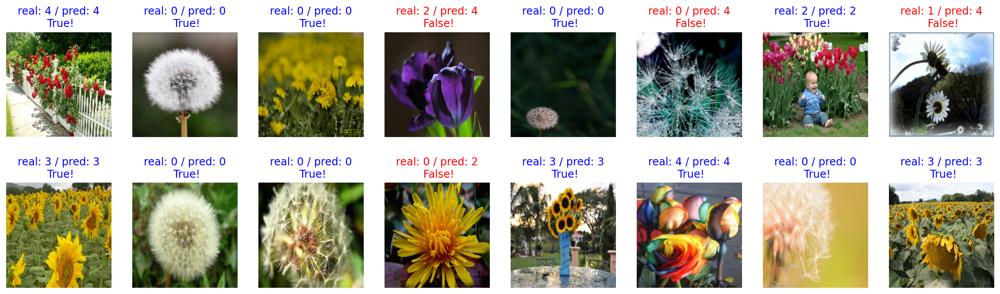

In [21]:
plt.figure(figsize=(20,12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1 ) / 2
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label} / pred: {prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color':'red'})
    else:
        plt.title(title, fontdict={'color':'blue'})
    plt.axis('off')

In [22]:
count = 0
for image, label, prediction in zip(images, labels, predictions):
    correct = label == prediction
    if correct:
        count = count + 1

print(count / 16 * 100) 

75.0


acc가 꾸준히 오르는것을 확인했다. 일단은 다른거 변경없이<br>
에포크수를 조금 높여보아야겠다.

In [23]:
EPOCHS = 20
history = model.fit(train_batches,
                   epochs=EPOCHS,
                   validation_data=validation_batches)

Epoch 1/20
184/184 [==============================] - 28s 151ms/step - loss: 0.7000 - accuracy: 0.7483 - val_loss: 0.9393 - val_accuracy: 0.6403
Epoch 2/20
184/184 [==============================] - 28s 152ms/step - loss: 0.6603 - accuracy: 0.7643 - val_loss: 0.8412 - val_accuracy: 0.7411
Epoch 3/20
184/184 [==============================] - 28s 150ms/step - loss: 0.5969 - accuracy: 0.7980 - val_loss: 0.9202 - val_accuracy: 0.7084
Epoch 4/20
184/184 [==============================] - 28s 151ms/step - loss: 0.5436 - accuracy: 0.8127 - val_loss: 0.9536 - val_accuracy: 0.7248
Epoch 5/20
184/184 [==============================] - 28s 151ms/step - loss: 0.4886 - accuracy: 0.8406 - val_loss: 1.2151 - val_accuracy: 0.7030
Epoch 6/20
184/184 [==============================] - 28s 151ms/step - loss: 0.4588 - accuracy: 0.8512 - val_loss: 1.1130 - val_accuracy: 0.7493
Epoch 7/20
184/184 [==============================] - 28s 151ms/step - loss: 0.4129 - accuracy: 0.8634 - val_loss: 1.1334 - val_ac

In [24]:
# 모델 평가
evaluation = model.evaluate(validation_batches)

# 평가 결과 출력
print("Loss:", evaluation[0])
print("Accuracy:", evaluation[1])

23/23 [==============================] - 1s 37ms/step - loss: 3.4432 - accuracy: 0.7193
Loss: 3.4431943893432617
Accuracy: 0.7193460464477539


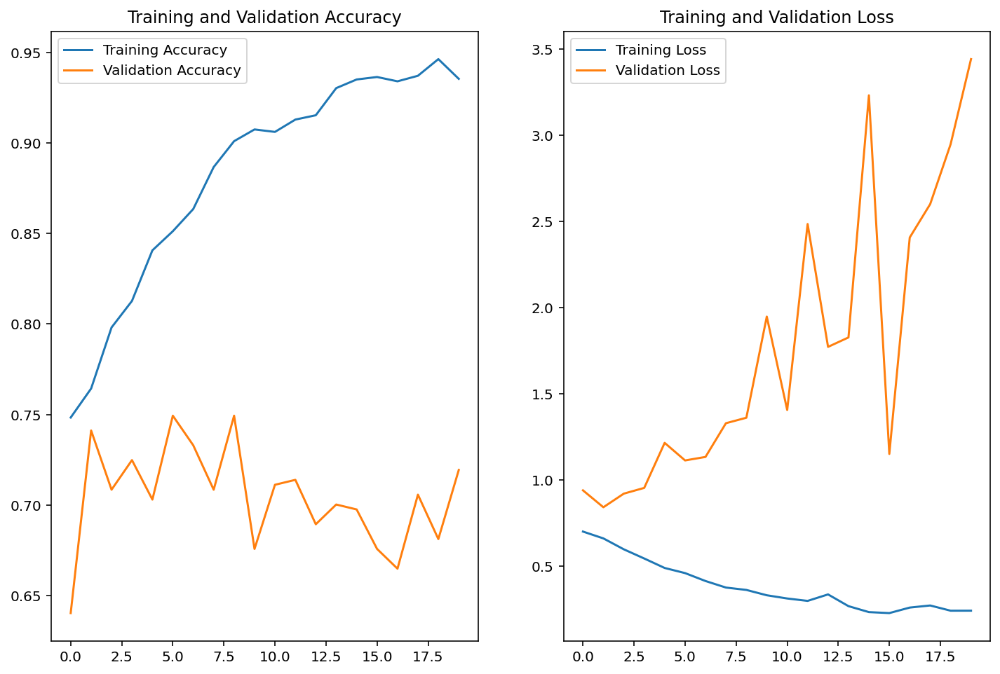

In [25]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(EPOCHS)

plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

In [26]:
for image_batch, label_batch in test_batches.take(1): #.take 첫 번째 배치를 가져오는 역할
        images = image_batch
        labels = label_batch
        predictions = model.predict(image_batch)
        break
        
predictions


array([[5.1427133e-30, 1.5416890e-26, 3.7478746e-17, 4.8071284e-28,
        1.0000000e+00],
       [1.0000000e+00, 1.4153833e-38, 4.4075359e-35, 4.0977841e-37,
        7.2301334e-35],
       [2.0392086e-09, 3.5186209e-13, 3.0322418e-08, 1.0000000e+00,
        1.0896953e-10],
       [3.8403176e-02, 7.4365295e-02, 4.5805541e-01, 3.6987778e-02,
        3.9218831e-01],
       [1.0000000e+00, 3.1573624e-10, 5.0859539e-10, 5.8600581e-12,
        3.0765374e-10],
       [1.9085190e-01, 2.5509852e-01, 1.9261728e-01, 1.4832604e-01,
        2.1310624e-01],
       [4.4206192e-14, 3.4875842e-11, 8.5988361e-01, 2.4635092e-12,
        1.4011641e-01],
       [2.4793756e-01, 1.2524915e-01, 2.6992583e-01, 1.3689707e-01,
        2.1999042e-01],
       [1.0064192e-27, 0.0000000e+00, 1.5142405e-36, 1.0000000e+00,
        0.0000000e+00],
       [1.0000000e+00, 0.0000000e+00, 1.0027047e-37, 0.0000000e+00,
        1.0606197e-37],
       [9.9995542e-01, 2.4973397e-06, 2.4974754e-06, 2.0921966e-06,
        3.74

In [27]:
predictions = np.argmax(predictions, axis=1)
predictions

array([4, 0, 3, 2, 0, 1, 2, 2, 3, 0, 0, 0, 3, 2, 0, 3])

In [28]:
# 모델 평가
test_evaluation = model.evaluate(test_batches)

# 테스트 정확도 출력
test_accuracy = test_evaluation[1]
print("Test Accuracy:", test_accuracy)


23/23 [==============================] - 1s 37ms/step - loss: 3.5500 - accuracy: 0.7275
Test Accuracy: 0.7275204062461853


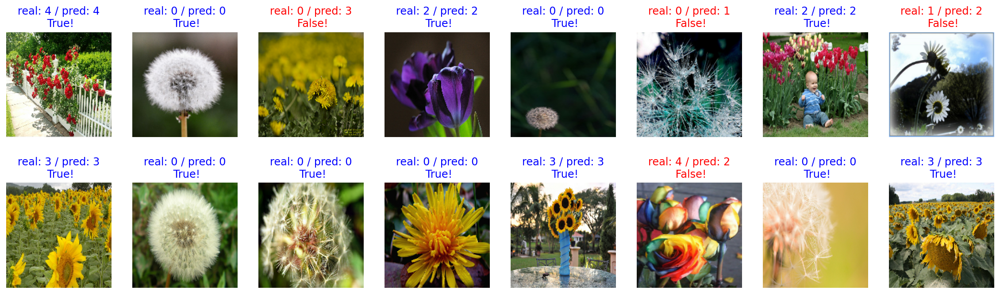

In [29]:
plt.figure(figsize=(20,12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1 ) / 2
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label} / pred: {prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color':'red'})
    else:
        plt.title(title, fontdict={'color':'blue'})
    plt.axis('off')

In [31]:
count = 0
for image, label, prediction in zip(images, labels, predictions):
    correct = label == prediction
    if correct:
        count = count + 1

print(count / 16 * 100) # 

75.0


validation accuracy가 조금 올랐지만 validation loss가 크게 증가했다가<br>
아주 조금 줄어든느 모습을 보였다.과적합이 보이는 것 같아보여서<br>
레이어에 dropout, batchnormalization을 추가 하고<br>
batch 사이즈를 다시 돌려놓은 상태에서 학습을 진행해보아야겠다.

In [32]:
BATCH_SIZE=32
SHUFFLE_BUFFER_SIZE = 1000


train_batches = train.shuffle(SHUFFLE_BUFFER_SIZE).batch(BATCH_SIZE)
validation_batches = validation.batch(BATCH_SIZE)
test_batches = test.batch(BATCH_SIZE)

In [33]:
# dense 층을 늘림

input_layer=tf.keras.layers.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
# Block 1
x=tf.keras.layers.Conv2D(64, (3, 3), strides=1, activation='relu', padding='same')(input_layer)
x=tf.keras.layers.Conv2D(64, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.BatchNormalization()(x)
x=tf.keras.layers.MaxPool2D((2, 2))(x)
x=tf.keras.layers.Dropout(0.5)(x)

# Block 2
x=tf.keras.layers.Conv2D(128, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.Conv2D(128, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.BatchNormalization()(x)
x=tf.keras.layers.MaxPool2D((2, 2))(x)
x=tf.keras.layers.Dropout(0.5)(x)

# Block 3
x=tf.keras.layers.Conv2D(256, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.Conv2D(256, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.Conv2D(256, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.BatchNormalization()(x)
x=tf.keras.layers.MaxPool2D((2, 2))(x)
x=tf.keras.layers.Dropout(0.5)(x)

# Block 4
x=tf.keras.layers.Conv2D(512, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.Conv2D(512, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.Conv2D(512, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.BatchNormalization()(x)
x=tf.keras.layers.MaxPool2D((2, 2))(x)
x=tf.keras.layers.Dropout(0.5)(x)
# Block 5
x=tf.keras.layers.Conv2D(512, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.Conv2D(512, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.BatchNormalization()(x)
x=tf.keras.layers.MaxPool2D((2, 2))(x)
x=tf.keras.layers.Dropout(0.5)(x)


x=tf.keras.layers.Flatten()(x)
x=tf.keras.layers.Dense(4096, activation='relu')(x)
x=tf.keras.layers.Dense(4096, activation='relu')(x)
x=tf.keras.layers.Dropout(0.5)(x)
x=tf.keras.layers.Dense(1000, activation='relu')(x)
x=tf.keras.layers.Dense(256, activation='relu')(x)
x=tf.keras.layers.Dropout(0.5)(x)
out_layer=tf.keras.layers.Dense(5, activation='softmax')(x)

model = tf.keras.Model(inputs=[input_layer], outputs=[out_layer])
model.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 160, 160, 3)]     0         
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 160, 160, 64)      1792      
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 160, 160, 64)      36928     
_________________________________________________________________
batch_normalization (BatchNo (None, 160, 160, 64)      256       
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 80, 80, 64)        0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 80, 80, 64)        0         
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 80, 80, 128)       7385

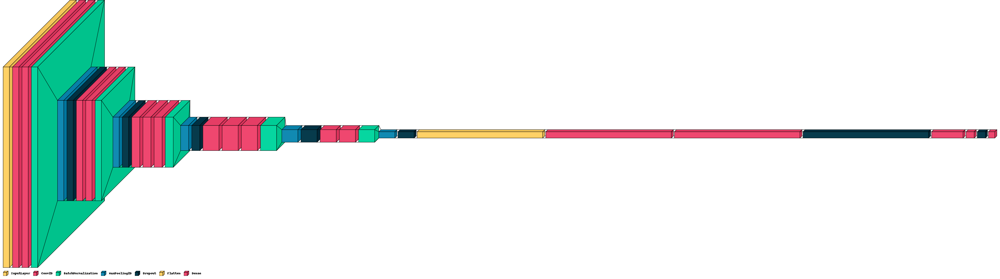

In [34]:
visualkeras.layered_view(model,legend=True)

In [35]:
learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=learning_rate),
             loss=tf.keras.losses.sparse_categorical_crossentropy,
             metrics=['accuracy'])

In [36]:
EPOCHS = 20
history = model.fit(train_batches,
                   epochs=EPOCHS,
                   validation_data=validation_batches)

Epoch 1/20
92/92 [==============================] - 39s 332ms/step - loss: 2.1442 - accuracy: 0.2728 - val_loss: 1.7315 - val_accuracy: 0.2425
Epoch 2/20
92/92 [==============================] - 25s 270ms/step - loss: 1.6310 - accuracy: 0.2888 - val_loss: 2.0806 - val_accuracy: 0.2425
Epoch 3/20
92/92 [==============================] - 25s 268ms/step - loss: 1.5288 - accuracy: 0.3375 - val_loss: 6.3707 - val_accuracy: 0.2425
Epoch 4/20
92/92 [==============================] - 25s 270ms/step - loss: 1.3800 - accuracy: 0.4275 - val_loss: 3.8312 - val_accuracy: 0.2425
Epoch 5/20
92/92 [==============================] - 25s 270ms/step - loss: 1.2729 - accuracy: 0.4854 - val_loss: 4.3049 - val_accuracy: 0.2425
Epoch 6/20
92/92 [==============================] - 25s 269ms/step - loss: 1.1891 - accuracy: 0.5163 - val_loss: 2.3697 - val_accuracy: 0.3515
Epoch 7/20
92/92 [==============================] - 25s 269ms/step - loss: 1.1071 - accuracy: 0.5599 - val_loss: 1.8502 - val_accuracy: 0.3624

In [37]:
# 모델 평가
evaluation = model.evaluate(validation_batches)

# 평가 결과 출력
print("Loss:", evaluation[0])
print("Accuracy:", evaluation[1])

12/12 [==============================] - 1s 65ms/step - loss: 1.1350 - accuracy: 0.6594
Loss: 1.1350210905075073
Accuracy: 0.6594005227088928


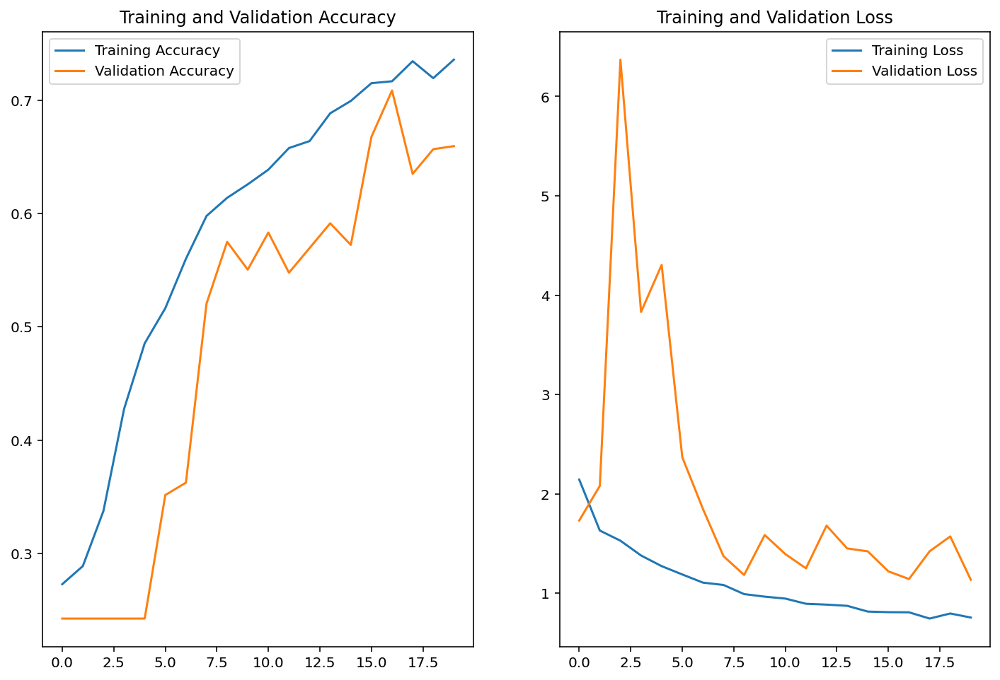

In [38]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(EPOCHS)

plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

In [39]:
for image_batch, label_batch in test_batches.take(1): #.take 첫 번째 배치를 가져오는 역할
        images = image_batch
        labels = label_batch
        predictions = model.predict(image_batch)
        break
        
predictions


array([[3.04753621e-06, 4.22994963e-05, 9.27217901e-01, 1.08330816e-04,
        7.26284683e-02],
       [9.99997616e-01, 1.03152679e-07, 4.88438388e-07, 1.74886217e-11,
        1.73494732e-06],
       [8.81108463e-01, 1.22986957e-02, 2.47529857e-02, 7.52648786e-02,
        6.57496788e-03],
       [5.76999560e-02, 4.18847278e-02, 4.52349007e-01, 6.20788522e-02,
        3.85987461e-01],
       [7.67976224e-01, 8.75228494e-02, 4.05402966e-02, 1.00983521e-02,
        9.38622281e-02],
       [9.31885302e-01, 2.64840946e-02, 1.23228664e-02, 1.00587367e-03,
        2.83018742e-02],
       [1.48183237e-11, 4.76200225e-11, 9.99920964e-01, 2.92992341e-09,
        7.90651102e-05],
       [4.51210111e-01, 3.73056114e-01, 6.89822882e-02, 6.32977784e-02,
        4.34537902e-02],
       [1.76648498e-02, 1.22038646e-08, 7.95689970e-03, 9.74366307e-01,
        1.19297110e-05],
       [9.99994278e-01, 2.45696782e-07, 7.75956778e-07, 8.13010215e-11,
        4.58983277e-06],
       [9.99563038e-01, 1.5009

In [40]:
predictions = np.argmax(predictions, axis=1)
predictions

array([2, 0, 0, 2, 0, 0, 2, 0, 3, 0, 0, 0, 3, 2, 0, 3, 2, 3, 0, 2, 2, 0,
       1, 0, 1, 3, 1, 2, 2, 0, 0, 0])

In [41]:
# 모델 평가
test_evaluation = model.evaluate(test_batches)

# 테스트 정확도 출력
test_accuracy = test_evaluation[1]
print("Test Accuracy:", test_accuracy)


12/12 [==============================] - 1s 64ms/step - loss: 1.0514 - accuracy: 0.6757
Test Accuracy: 0.6757493019104004


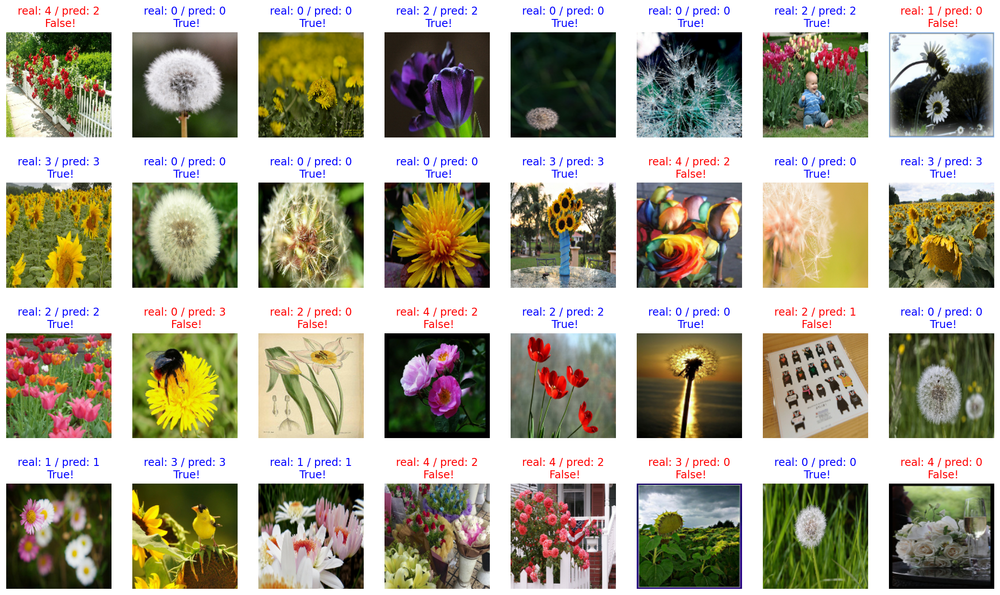

In [42]:
plt.figure(figsize=(20,12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1 ) / 2
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label} / pred: {prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color':'red'})
    else:
        plt.title(title, fontdict={'color':'blue'})
    plt.axis('off')

In [43]:
count = 0
for image, label, prediction in zip(images, labels, predictions):
    correct = label == prediction
    if correct:
        count = count + 1

print(count / 32 * 100) # 약 95% 내외

65.625


오히려 성능이 더 떨어지는 것을 확인했다.<br>
배치사이즈는 줄여서 학습량을 늘리는 것은 맞는거 같다.<br>
이 모델이 좀 복잡해 보이니 모델을 간소화 해서 학습을 진행

In [44]:
BATCH_SIZE=8
SHUFFLE_BUFFER_SIZE = 1000


train_batches = train.shuffle(SHUFFLE_BUFFER_SIZE).batch(BATCH_SIZE)
validation_batches = validation.batch(BATCH_SIZE)
test_batches = test.batch(BATCH_SIZE)

In [45]:
input_layer = tf.keras.layers.Input(shape=(IMG_SIZE, IMG_SIZE, 3))

# Convolutional Blocks
x = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', padding='same')(input_layer)
x = tf.keras.layers.MaxPooling2D((2, 2))(x)
x = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', padding='same')(x)
x = tf.keras.layers.MaxPooling2D((2, 2))(x)
x = tf.keras.layers.Conv2D(256, (3, 3), activation='relu', padding='same')(x)
x = tf.keras.layers.MaxPooling2D((2, 2))(x)

# Flatten and Dense Layers
x = tf.keras.layers.Flatten()(x)
x = tf.keras.layers.Dense(256, activation='relu')(x)
x = tf.keras.layers.Dropout(0.5)(x)

# Output Layer
output_layer = tf.keras.layers.Dense(5, activation='softmax')(x)

# Model
model = tf.keras.Model(inputs=input_layer, outputs=output_layer)

model.summary()


Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 160, 160, 3)]     0         
_________________________________________________________________
conv2d_25 (Conv2D)           (None, 160, 160, 64)      1792      
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 80, 80, 64)        0         
_________________________________________________________________
conv2d_26 (Conv2D)           (None, 80, 80, 128)       73856     
_________________________________________________________________
max_pooling2d_11 (MaxPooling (None, 40, 40, 128)       0         
_________________________________________________________________
conv2d_27 (Conv2D)           (None, 40, 40, 256)       295168    
_________________________________________________________________
max_pooling2d_12 (MaxPooling (None, 20, 20, 256)       0   

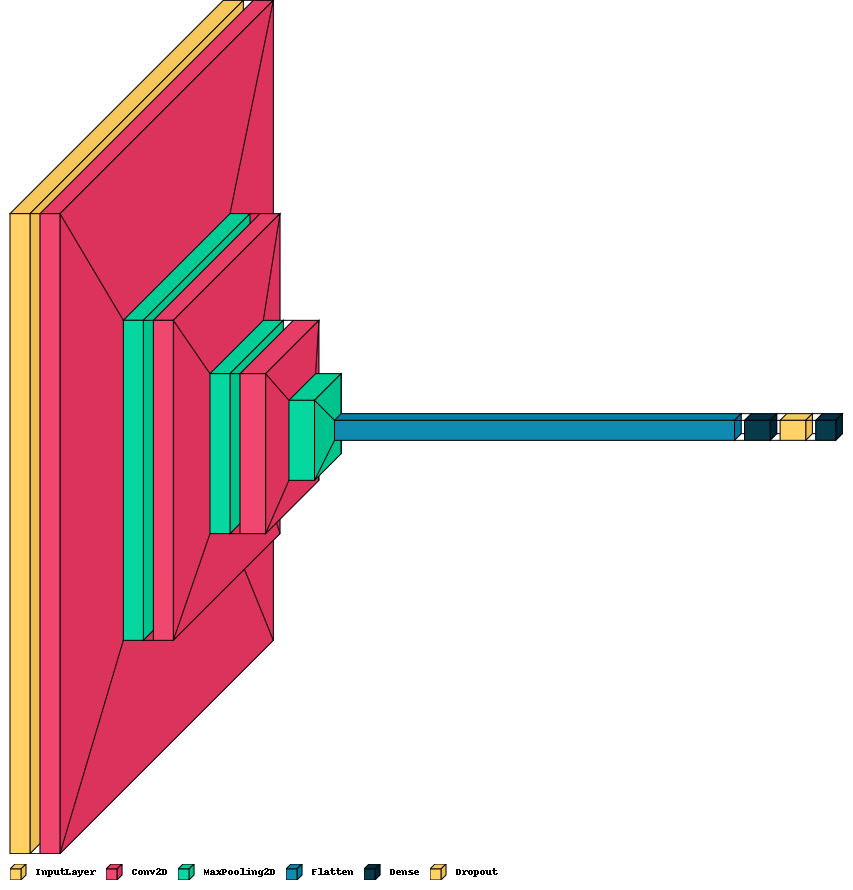

In [46]:
visualkeras.layered_view(model,legend=True)

In [47]:
learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=learning_rate),
             loss=tf.keras.losses.sparse_categorical_crossentropy,
             metrics=['accuracy'])

In [48]:
EPOCHS = 20
history = model.fit(train_batches,
                   epochs=EPOCHS,
                   validation_data=validation_batches)

Epoch 1/20
367/367 [==============================] - 11s 28ms/step - loss: 1.2489 - accuracy: 0.4656 - val_loss: 1.0164 - val_accuracy: 0.6104
Epoch 2/20
367/367 [==============================] - 10s 27ms/step - loss: 1.0101 - accuracy: 0.6087 - val_loss: 0.8908 - val_accuracy: 0.6567
Epoch 3/20
367/367 [==============================] - 10s 27ms/step - loss: 0.8577 - accuracy: 0.6737 - val_loss: 0.9038 - val_accuracy: 0.6403
Epoch 4/20
367/367 [==============================] - 10s 27ms/step - loss: 0.7483 - accuracy: 0.7333 - val_loss: 0.8148 - val_accuracy: 0.7003
Epoch 5/20
367/367 [==============================] - 10s 27ms/step - loss: 0.6384 - accuracy: 0.7779 - val_loss: 0.7971 - val_accuracy: 0.7112
Epoch 6/20
367/367 [==============================] - 10s 27ms/step - loss: 0.5569 - accuracy: 0.7990 - val_loss: 0.8259 - val_accuracy: 0.7030
Epoch 7/20
367/367 [==============================] - 10s 27ms/step - loss: 0.4735 - accuracy: 0.8403 - val_loss: 0.7983 - val_accuracy:

In [49]:
# 모델 평가
evaluation = model.evaluate(validation_batches)

# 평가 결과 출력
print("Loss:", evaluation[0])
print("Accuracy:", evaluation[1])

46/46 [==============================] - 0s 6ms/step - loss: 1.2341 - accuracy: 0.7193
Loss: 1.23407781124115
Accuracy: 0.7193460464477539


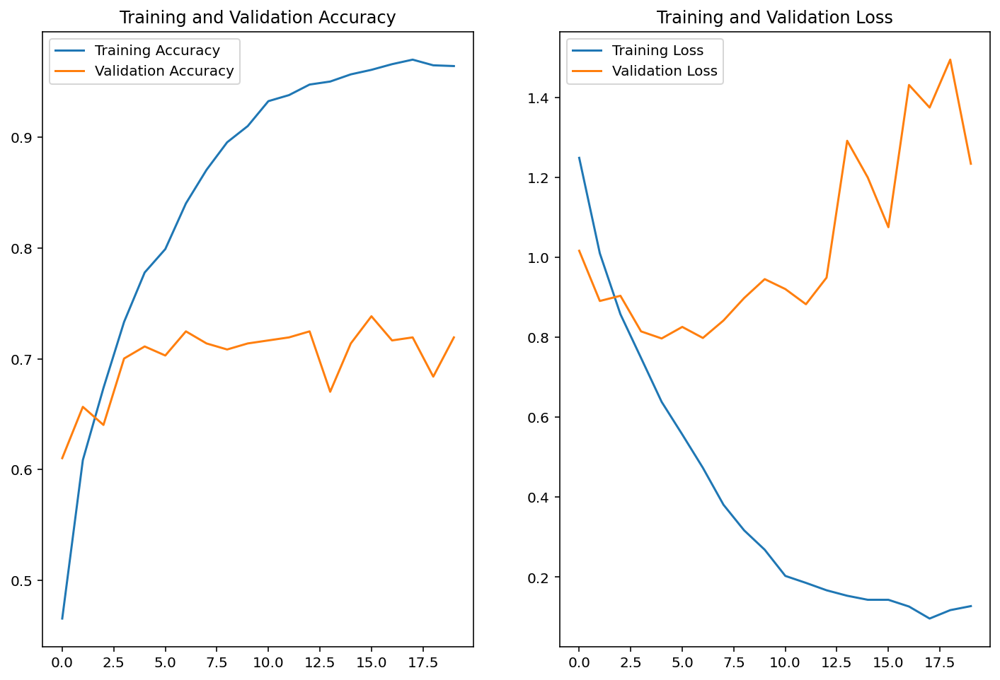

In [50]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(EPOCHS)

plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

In [51]:
for image_batch, label_batch in test_batches.take(1): #.take 첫 번째 배치를 가져오는 역할
        images = image_batch
        labels = label_batch
        predictions = model.predict(image_batch)
        break
        
predictions


array([[5.21482093e-07, 2.11846709e-05, 3.21388334e-01, 5.06516546e-04,
        6.78083420e-01],
       [9.99248445e-01, 6.43611827e-04, 7.87113968e-05, 7.38694155e-07,
        2.84287016e-05],
       [9.79283154e-01, 5.62595778e-05, 6.40923204e-03, 1.39344037e-02,
        3.17003083e-04],
       [6.13122771e-04, 5.95647059e-02, 8.06462824e-01, 1.04937506e-04,
        1.33254290e-01],
       [4.20794070e-01, 1.53923526e-01, 1.27892226e-01, 1.48159042e-01,
        1.49231091e-01],
       [8.68561804e-01, 2.43261713e-03, 3.83024812e-02, 1.42918257e-02,
        7.64113665e-02],
       [3.64282528e-07, 2.14748573e-03, 9.96900082e-01, 1.36071390e-06,
        9.50860383e-04],
       [3.94959818e-04, 7.35551203e-06, 2.99918611e-04, 1.15563114e-06,
        9.99296546e-01]], dtype=float32)

In [52]:
predictions = np.argmax(predictions, axis=1)
predictions

array([4, 0, 0, 2, 0, 0, 2, 4])

In [53]:
# 모델 평가
test_evaluation = model.evaluate(test_batches)

# 테스트 정확도 출력
test_accuracy = test_evaluation[1]
print("Test Accuracy:", test_accuracy)


46/46 [==============================] - 0s 6ms/step - loss: 1.0899 - accuracy: 0.7221
Test Accuracy: 0.7220708727836609


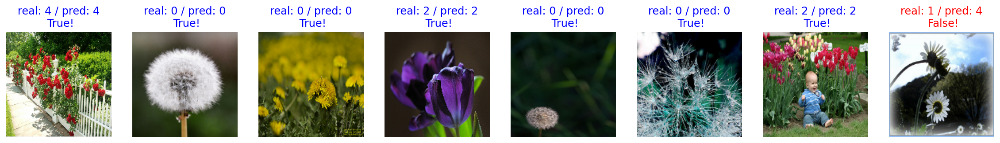

In [54]:
plt.figure(figsize=(20,12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1 ) / 2
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label} / pred: {prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color':'red'})
    else:
        plt.title(title, fontdict={'color':'blue'})
    plt.axis('off')

In [55]:
count = 0
for image, label, prediction in zip(images, labels, predictions):
    correct = label == prediction
    if correct:
        count = count + 1

print(count / 8 * 100) # 약 95% 내외

87.5


배치정규화, 가중치 초기화를 추가해서 시도를 해보아야겠다.<br>
그리고 learning_rate 를 조금 올려야겠다.

In [56]:
input_layer = tf.keras.layers.Input(shape=(IMG_SIZE, IMG_SIZE, 3))

# Convolutional Blocks
x = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', padding='same')(input_layer)
x = tf.keras.layers.BatchNormalization()(x)
x = tf.keras.layers.MaxPooling2D((2, 2))(x)
x = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', padding='same')(x)
x = tf.keras.layers.BatchNormalization()(x)
x = tf.keras.layers.MaxPooling2D((2, 2))(x)
x = tf.keras.layers.Conv2D(256, (3, 3), activation='relu', padding='same')(x)
x = tf.keras.layers.BatchNormalization()(x)
x = tf.keras.layers.MaxPooling2D((2, 2))(x)

# Flatten and Dense Layers
x = tf.keras.layers.Flatten()(x)
x = tf.keras.layers.Dense(256, activation='relu', kernel_initializer='he_normal')(x)
x = tf.keras.layers.BatchNormalization()(x)
x = tf.keras.layers.Dropout(0.5)(x)

# Output Layer
output_layer = tf.keras.layers.Dense(5, activation='softmax')(x)

# Model
model = tf.keras.Model(inputs=input_layer, outputs=output_layer)

model.summary()


Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 160, 160, 3)]     0         
_________________________________________________________________
conv2d_28 (Conv2D)           (None, 160, 160, 64)      1792      
_________________________________________________________________
batch_normalization_5 (Batch (None, 160, 160, 64)      256       
_________________________________________________________________
max_pooling2d_13 (MaxPooling (None, 80, 80, 64)        0         
_________________________________________________________________
conv2d_29 (Conv2D)           (None, 80, 80, 128)       73856     
_________________________________________________________________
batch_normalization_6 (Batch (None, 80, 80, 128)       512       
_________________________________________________________________
max_pooling2d_14 (MaxPooling (None, 40, 40, 128)       0   

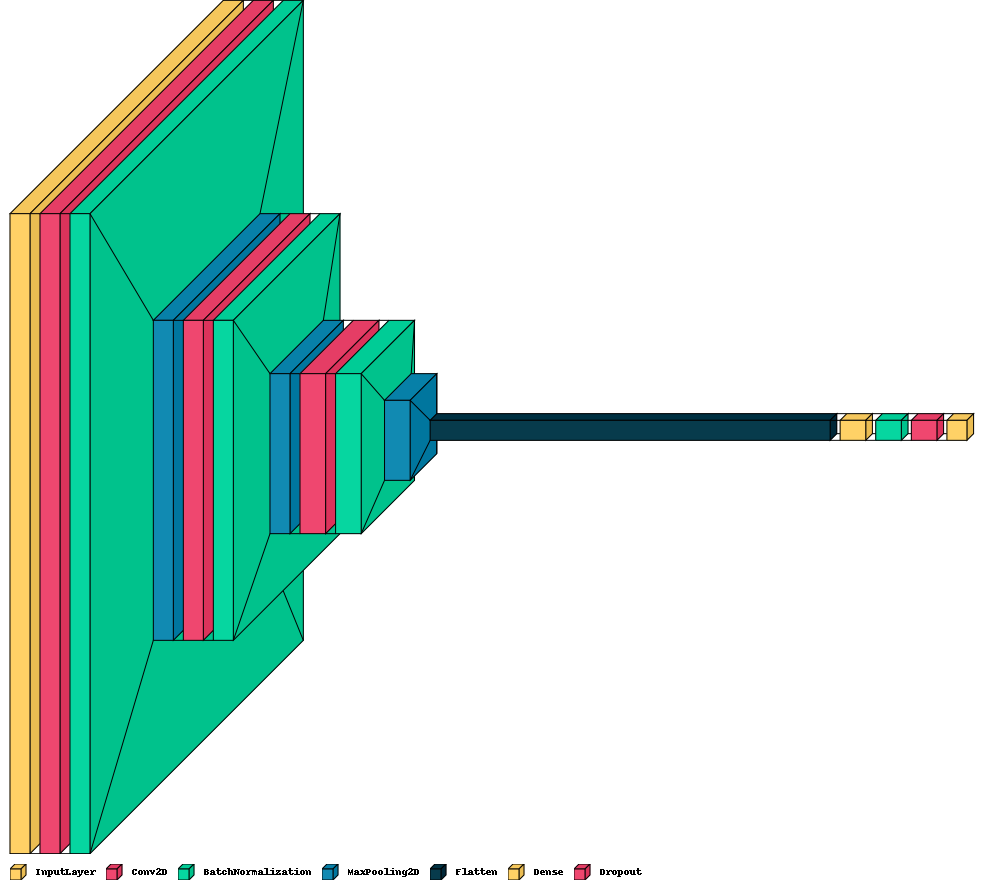

In [57]:
visualkeras.layered_view(model,legend=True)

In [58]:
learning_rate = 0.001
model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=learning_rate),
             loss=tf.keras.losses.sparse_categorical_crossentropy,
             metrics=['accuracy'])

In [59]:
EPOCHS = 20
history = model.fit(train_batches,
                   epochs=EPOCHS,
                   validation_data=validation_batches)

Epoch 1/20
367/367 [==============================] - 13s 32ms/step - loss: 1.8834 - accuracy: 0.4125 - val_loss: 1.4197 - val_accuracy: 0.4932
Epoch 2/20
367/367 [==============================] - 12s 31ms/step - loss: 1.3573 - accuracy: 0.5153 - val_loss: 0.9207 - val_accuracy: 0.6431
Epoch 3/20
367/367 [==============================] - 12s 31ms/step - loss: 1.1158 - accuracy: 0.5862 - val_loss: 0.8986 - val_accuracy: 0.6621
Epoch 4/20
367/367 [==============================] - 12s 31ms/step - loss: 0.9354 - accuracy: 0.6635 - val_loss: 0.7692 - val_accuracy: 0.6785
Epoch 5/20
367/367 [==============================] - 12s 31ms/step - loss: 0.8417 - accuracy: 0.6873 - val_loss: 0.7636 - val_accuracy: 0.7084
Epoch 6/20
367/367 [==============================] - 12s 31ms/step - loss: 0.7327 - accuracy: 0.7323 - val_loss: 0.9279 - val_accuracy: 0.6866
Epoch 7/20
367/367 [==============================] - 12s 31ms/step - loss: 0.6719 - accuracy: 0.7616 - val_loss: 0.8639 - val_accuracy:

In [ ]:
for image_batch, label_batch in test_batches.take(1): #.take 첫 번째 배치를 가져오는 역할
        images = image_batch
        labels = label_batch
        predictions = model.predict(image_batch)
        break
        
predictions


In [ ]:
predictions = np.argmax(predictions, axis=1)
predictions

In [60]:
# 모델 평가
evaluation = model.evaluate(validation_batches)

# 평가 결과 출력
print("Loss:", evaluation[0])
print("Accuracy:", evaluation[1])

46/46 [==============================] - 0s 7ms/step - loss: 1.3301 - accuracy: 0.6894
Loss: 1.3300904035568237
Accuracy: 0.6893733143806458


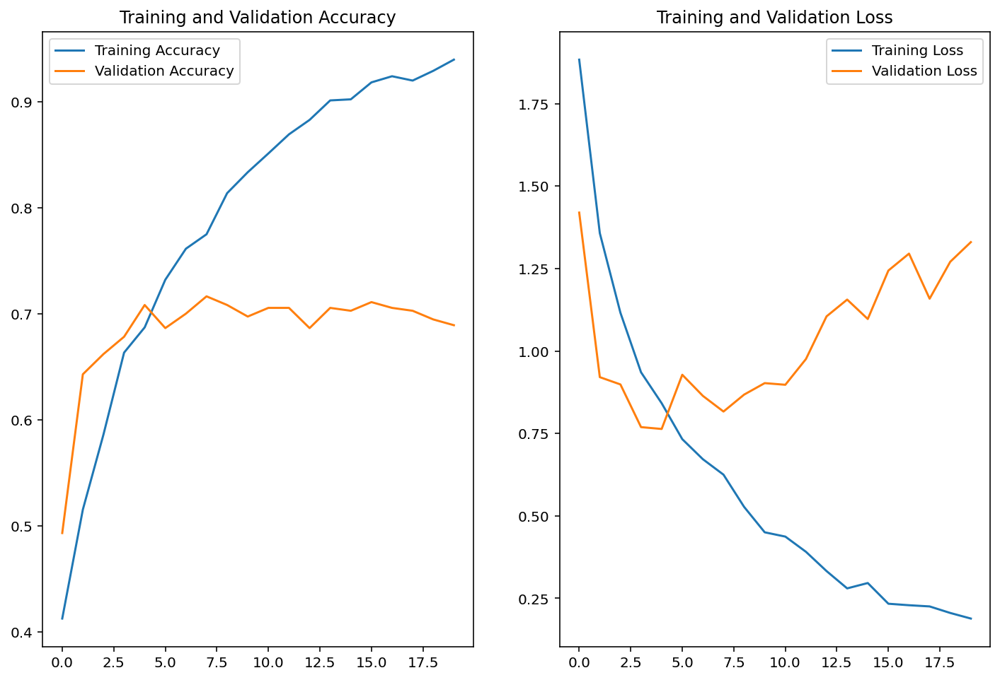

In [61]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(EPOCHS)

plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

In [62]:
# 모델 평가
test_evaluation = model.evaluate(test_batches)

# 테스트 정확도 출력
test_accuracy = test_evaluation[1]
print("Test Accuracy:", test_accuracy)


46/46 [==============================] - 0s 7ms/step - loss: 1.1010 - accuracy: 0.6785
Test Accuracy: 0.6784741282463074


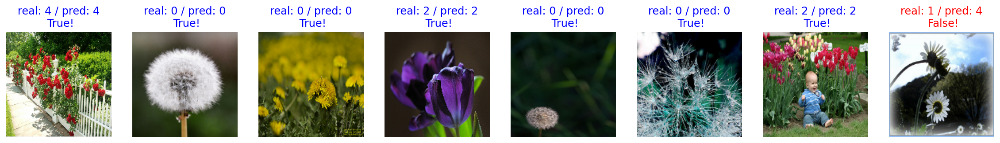

In [63]:
plt.figure(figsize=(20,12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1 ) / 2
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label} / pred: {prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color':'red'})
    else:
        plt.title(title, fontdict={'color':'blue'})
    plt.axis('off')

In [64]:
count = 0
for image, label, prediction in zip(images, labels, predictions):
    correct = label == prediction
    if correct:
        count = count + 1

print(count / 8 * 100) # 약 95% 내외

87.5


역시나 직접 레이어를 쌓고 학습을 시켜<br>
높은 정확도를 높이기에는 너무 어렵다는걸 확인할 수 있었다.<br>
pre-traine model을 사용하여 정확도를 높여보아야겠다.<br>
이미지가 적고 이미 imagnet에 꽃과같은 데이터가 학습이 되어 있기 때문에<br>
출력부분만 학습(fc)진행

In [65]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy

base_model = VGG16(weights='imagenet', include_top=False, input_shape=(IMG_SIZE, IMG_SIZE, 3))

# Freeze convolutional base
base_model.trainable = False

# Add custom top layers for new classification task
flatten_layer = Flatten()(base_model.output)
dense_layer_1 = Dense(256, activation='relu')(flatten_layer)
dropout_layer = Dropout(0.5)(dense_layer_1)
output_layer = Dense(5, activation='softmax')(dropout_layer) 
# Create the new model
model = Model(inputs=base_model.input, outputs=output_layer)

# Compile the model
model.compile(optimizer=Adam(lr=0.001), loss=SparseCategoricalCrossentropy(), metrics=['accuracy'])

# Display model summary
model.summary()

Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_5 (InputLayer)         [(None, 160, 160, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 160, 160, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 160, 160, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 80, 80, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 80, 80, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 80, 80, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 40, 40, 128)       0   

In [66]:
EPOCHS = 20
history = model.fit(train_batches,
                   epochs=EPOCHS,
                   validation_data=validation_batches)

Epoch 1/20
367/367 [==============================] - 14s 37ms/step - loss: 1.0668 - accuracy: 0.6298 - val_loss: 0.6281 - val_accuracy: 0.7793
Epoch 2/20
367/367 [==============================] - 13s 34ms/step - loss: 0.6932 - accuracy: 0.7473 - val_loss: 0.5159 - val_accuracy: 0.7929
Epoch 3/20
367/367 [==============================] - 13s 34ms/step - loss: 0.5222 - accuracy: 0.8072 - val_loss: 0.5661 - val_accuracy: 0.7902
Epoch 4/20
367/367 [==============================] - 13s 34ms/step - loss: 0.4428 - accuracy: 0.8280 - val_loss: 0.5115 - val_accuracy: 0.8065
Epoch 5/20
367/367 [==============================] - 13s 33ms/step - loss: 0.3502 - accuracy: 0.8692 - val_loss: 0.5579 - val_accuracy: 0.7956
Epoch 6/20
367/367 [==============================] - 13s 33ms/step - loss: 0.3285 - accuracy: 0.8760 - val_loss: 0.5227 - val_accuracy: 0.8147
Epoch 7/20
367/367 [==============================] - 13s 33ms/step - loss: 0.2884 - accuracy: 0.8944 - val_loss: 0.5619 - val_accuracy:

In [ ]:
for image_batch, label_batch in test_batches.take(1): #.take 첫 번째 배치를 가져오는 역할
        images = image_batch
        labels = label_batch
        predictions = model.predict(image_batch)
        break
        
predictions


In [ ]:
predictions = np.argmax(predictions, axis=1)
predictions

In [67]:
# 모델 평가
evaluation = model.evaluate(validation_batches)

# 평가 결과 출력
print("Loss:", evaluation[0])
print("Accuracy:", evaluation[1])

46/46 [==============================] - 1s 28ms/step - loss: 0.6298 - accuracy: 0.8529
Loss: 0.6298025846481323
Accuracy: 0.8528610467910767


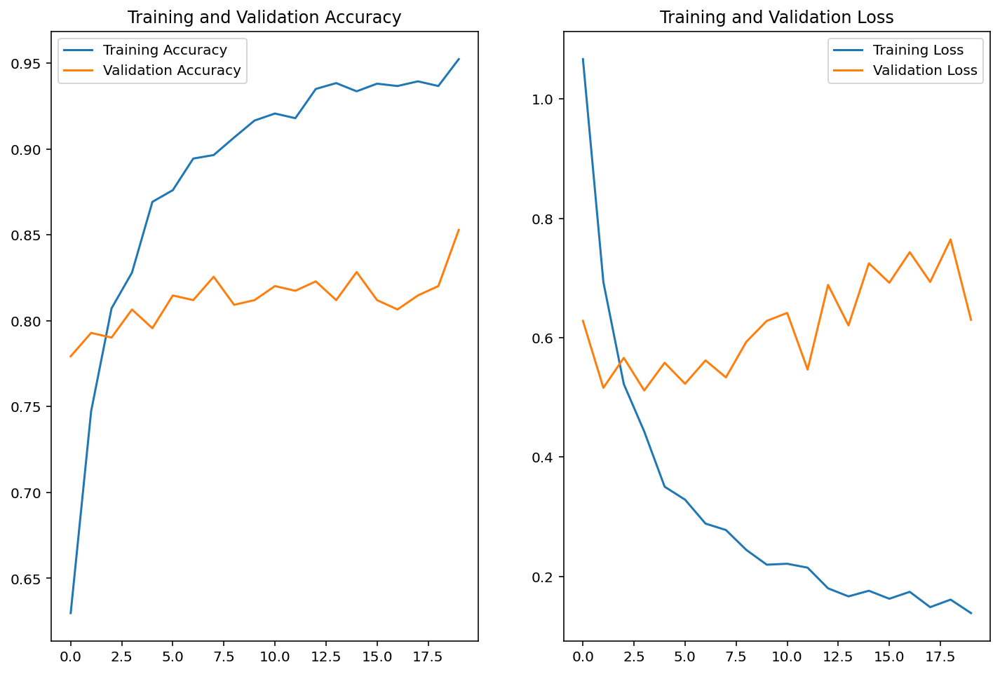

In [68]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(EPOCHS)

plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

In [69]:
# 모델 평가
test_evaluation = model.evaluate(test_batches)

# 테스트 정확도 출력
test_accuracy = test_evaluation[1]
print("Test Accuracy:", test_accuracy)


46/46 [==============================] - 1s 29ms/step - loss: 0.6498 - accuracy: 0.8529
Test Accuracy: 0.8528610467910767


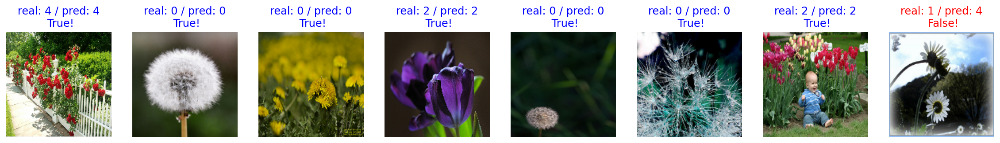

In [70]:
plt.figure(figsize=(20,12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1 ) / 2
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label} / pred: {prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color':'red'})
    else:
        plt.title(title, fontdict={'color':'blue'})
    plt.axis('off')

In [71]:
count = 0
for image, label, prediction in zip(images, labels, predictions):
    correct = label == prediction
    if correct:
        count = count + 1

print(count / 8 * 100) # 약 95% 내외

87.5


85%도달 했다 <br>
역시 pre-train 이었다.<br>
조금만 더 실험을 해보고 싶었다.
layer의 앞부분 17개를 freeze 하고 학습을 진행하면 어떻게 될까?

In [213]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy

base_model = VGG16(weights='imagenet', include_top=False, input_shape=(IMG_SIZE, IMG_SIZE, 3))


# Freeze convolutional base 
for layer in base_model.layers[-15:]:
    layer.trainable = False

# Add custom top layers for new classification task
flatten_layer = Flatten()(base_model.output)
dense_layer_1 = Dense(256, activation='relu')(flatten_layer)
dropout_layer = Dropout(0.5)(dense_layer_1)
output_layer = Dense(5, activation='softmax')(dropout_layer) 
# Create the new model
model = Model(inputs=base_model.input, outputs=output_layer)

# Compile the model
model.compile(optimizer=Adam(lr=0.001), loss=SparseCategoricalCrossentropy(), metrics=['accuracy'])

# Display model summary
model.summary()

Model: "model_23"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_25 (InputLayer)        [(None, 160, 160, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 160, 160, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 160, 160, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 80, 80, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 80, 80, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 80, 80, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 40, 40, 128)       0  

In [214]:
EPOCHS = 20
history = model.fit(train_batches,
                   epochs=EPOCHS,
                   validation_data=validation_batches)

Epoch 1/20
367/367 [==============================] - 26s 66ms/step - loss: 1.0411 - accuracy: 0.6339 - val_loss: 0.6633 - val_accuracy: 0.7275
Epoch 2/20
367/367 [==============================] - 25s 67ms/step - loss: 0.6518 - accuracy: 0.7626 - val_loss: 0.5293 - val_accuracy: 0.7738
Epoch 3/20
367/367 [==============================] - 25s 66ms/step - loss: 0.5035 - accuracy: 0.8215 - val_loss: 0.5410 - val_accuracy: 0.7929
Epoch 4/20
367/367 [==============================] - 25s 66ms/step - loss: 0.4012 - accuracy: 0.8457 - val_loss: 0.5021 - val_accuracy: 0.8256
Epoch 5/20
367/367 [==============================] - 25s 66ms/step - loss: 0.3554 - accuracy: 0.8678 - val_loss: 0.6114 - val_accuracy: 0.8038
Epoch 6/20
367/367 [==============================] - 25s 66ms/step - loss: 0.3231 - accuracy: 0.8787 - val_loss: 0.5908 - val_accuracy: 0.8447
Epoch 7/20
367/367 [==============================] - 25s 66ms/step - loss: 0.2770 - accuracy: 0.9012 - val_loss: 0.5524 - val_accuracy:

## 모델 저장

In [251]:
checkpoint_dir = os.getenv("HOME") + "/aiffel/aiffel_quest/quest_240318/data/checkpoint"
checkpoint_file_path = os.path.join(checkpoint_dir, 'checkpoint.h5')
# print(checkpoint_file_path)
if not os.path.exists(checkpoint_dir):
    os.mkdir(checkpoint_dir)
    
model.save(checkpoint_file_path)     # checkpoint 파일 생성

if os.path.exists(checkpoint_file_path):
    print('h5 파일 생성 OK!!')

h5 파일 생성 OK!!


In [228]:
for image_batch, label_batch in test_batches.take(1): #.take 첫 번째 배치를 가져오는 역할
        images = image_batch
        labels = label_batch
        predictions = model.predict(image_batch)
        break
        
predictions

array([[7.09485725e-12, 2.29005814e-09, 9.99999046e-01, 2.45397369e-10,
        9.23829646e-07],
       [1.00000000e+00, 7.64813800e-22, 0.00000000e+00, 1.93105951e-24,
        0.00000000e+00],
       [9.99686956e-01, 7.38763993e-05, 8.19810975e-09, 2.38656343e-04,
        4.77138769e-07],
       [4.16913331e-08, 1.27812295e-04, 4.92377490e-01, 1.94023769e-07,
        5.07494450e-01],
       [7.99302757e-01, 1.96337685e-01, 4.44869584e-05, 2.32592705e-04,
        4.08247765e-03],
       [9.99400973e-01, 5.17887122e-04, 4.06571721e-10, 8.11245118e-05,
        6.10147044e-09],
       [1.40176635e-08, 7.94093069e-07, 9.93665874e-01, 5.34933279e-05,
        6.27977820e-03],
       [1.05731152e-01, 8.94211531e-01, 3.45811304e-06, 5.18445231e-05,
        1.97975714e-06]], dtype=float32)

In [229]:
predictions = np.argmax(predictions, axis=1)
predictions

array([2, 0, 0, 4, 0, 0, 2, 1])

In [126]:
# 모델 평가
evaluation = model.evaluate(validation_batches)

# 평가 결과 출력
print("Loss:", evaluation[0])
print("Accuracy:", evaluation[1])

46/46 [==============================] - 1s 28ms/step - loss: 0.7757 - accuracy: 0.8583
Loss: 0.7757467031478882
Accuracy: 0.8583106398582458


In [128]:
# 모델 평가
test_evaluation = model.evaluate(test_batches)

# 테스트 정확도 출력
test_accuracy = test_evaluation[1]
print("Test Accuracy:", test_accuracy)


46/46 [==============================] - 1s 29ms/step - loss: 0.6916 - accuracy: 0.8610
Test Accuracy: 0.8610354065895081


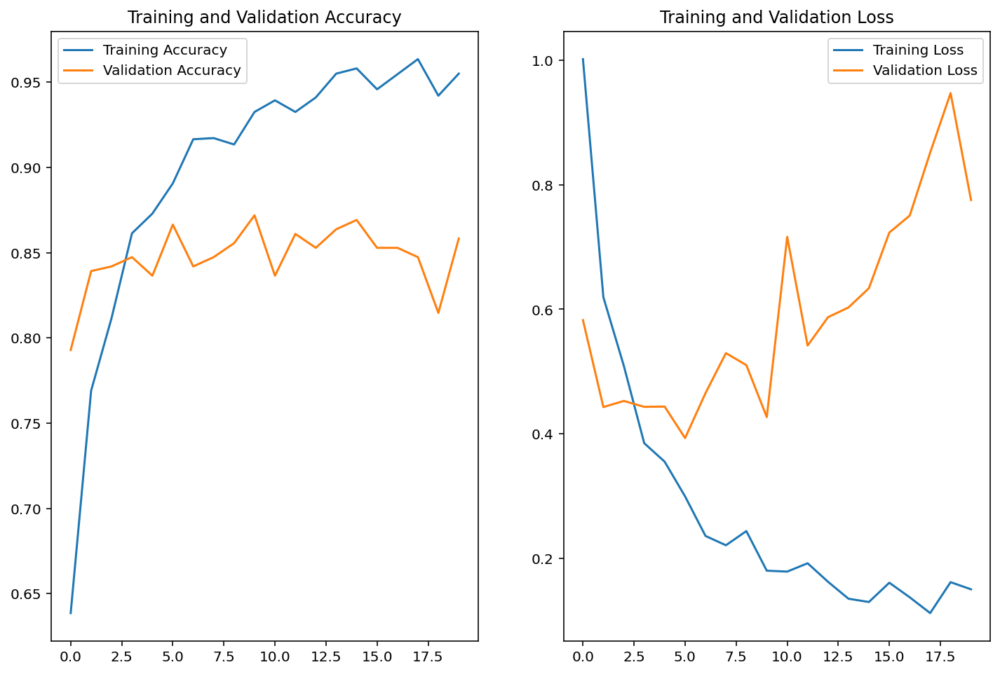

In [127]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(EPOCHS)

plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

In [219]:
from sklearn.metrics import classification_report

predictions = model.predict(test_batches)


labels = []
for _, label in test:
    labels.append(label.numpy())
np.array(labels)


class_names = metadata.features['label'].names


print(classification_report(labels, np.argmax(predictions, axis=-1), target_names=class_names))

              precision    recall  f1-score   support

   dandelion       0.88      0.90      0.89        70
       daisy       0.89      0.90      0.89        61
      tulips       0.78      0.89      0.83        85
  sunflowers       0.92      0.71      0.80        76
       roses       0.82      0.83      0.82        75

    accuracy                           0.84       367
   macro avg       0.85      0.85      0.85       367
weighted avg       0.85      0.84      0.84       367



In [287]:
predictions = model.predict(test_batches)

In [288]:
import seaborn as sns
from sklearn.metrics import confusion_matrix

plt.figure(figsize=(8, 8))
cm2 = confusion_matrix(labels, np.argmax(predictions, axis=-1))
sns.heatmap(cm2, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.xticks(ticks=np.arange(0.5, 5.5), labels=class_names, rotation=45, ha='right')
plt.yticks(ticks=np.arange(0.5, 5.5), labels=class_names, rotation=0)
plt.show()

ValueError: Found input variables with inconsistent numbers of samples: [8, 367]

<Figure size 576x576 with 0 Axes>

In [ ]:
predictions = np.argmax(predictions, axis=1)

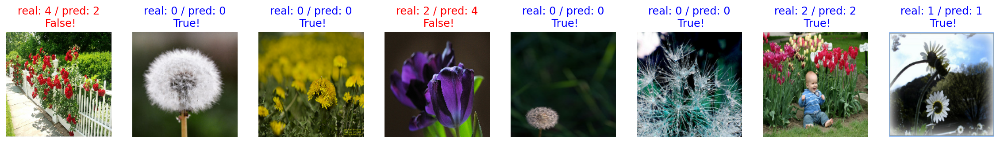

In [231]:
plt.figure(figsize=(20,12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1 ) / 2
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label} / pred: {prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color':'red'})
    else:
        plt.title(title, fontdict={'color':'blue'})
    plt.axis('off')

In [225]:
count = 0
for image, label, prediction in zip(images, labels, predictions):
    correct = label == prediction
    if correct:
        count = count + 1

print(count / 8 * 100) # 약 95% 내외

75.0


BatchNormalization 추가

In [133]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy

base_model = VGG16(weights='imagenet', include_top=False, input_shape=(IMG_SIZE, IMG_SIZE, 3))

# Freeze convolutional base
for layer in base_model.layers[-15:]:
    layer.trainable = False

# Add custom top layers for new classification task
flatten_layer = Flatten()(base_model.output)
dense_layer_1 = Dense(256, activation='relu')(flatten_layer)
batch_norm_layer = BatchNormalization()(dense_layer_1)
dropout_layer = Dropout(0.5)(batch_norm_layer)
output_layer = Dense(5, activation='softmax')(dropout_layer)
# Create the new model
model = Model(inputs=base_model.input, outputs=output_layer)

# Compile the model
model.compile(optimizer=Adam(lr=0.001), loss=SparseCategoricalCrossentropy(), metrics=['accuracy'])

# Display model summary
model.summary()

Model: "model_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_16 (InputLayer)        [(None, 160, 160, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 160, 160, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 160, 160, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 80, 80, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 80, 80, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 80, 80, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 40, 40, 128)       0  

In [134]:
EPOCHS = 20
history = model.fit(train_batches,
                   epochs=EPOCHS,
                   validation_data=validation_batches)

Epoch 1/20
367/367 [==============================] - 26s 67ms/step - loss: 0.9847 - accuracy: 0.6649 - val_loss: 0.5567 - val_accuracy: 0.8011
Epoch 2/20
367/367 [==============================] - 25s 67ms/step - loss: 0.5482 - accuracy: 0.7984 - val_loss: 0.5564 - val_accuracy: 0.8011
Epoch 3/20
367/367 [==============================] - 25s 66ms/step - loss: 0.4470 - accuracy: 0.8426 - val_loss: 0.4796 - val_accuracy: 0.8229
Epoch 4/20
367/367 [==============================] - 25s 66ms/step - loss: 0.3818 - accuracy: 0.8706 - val_loss: 0.4954 - val_accuracy: 0.8283
Epoch 5/20
367/367 [==============================] - 25s 66ms/step - loss: 0.3060 - accuracy: 0.8965 - val_loss: 0.6060 - val_accuracy: 0.7820
Epoch 6/20
367/367 [==============================] - 25s 66ms/step - loss: 0.3005 - accuracy: 0.9002 - val_loss: 0.4456 - val_accuracy: 0.8420
Epoch 7/20
367/367 [==============================] - 25s 66ms/step - loss: 0.2667 - accuracy: 0.9040 - val_loss: 0.4962 - val_accuracy:

In [ ]:
for image_batch, label_batch in test_batches.take(1): #.take 첫 번째 배치를 가져오는 역할
        images = image_batch
        labels = label_batch
        predictions = model.predict(image_batch)
        break
        
predictions

In [ ]:
predictions = np.argmax(predictions, axis=1)
predictions

In [135]:
# 모델 평가
evaluation = model.evaluate(validation_batches)

# 평가 결과 출력
print("Loss:", evaluation[0])
print("Accuracy:", evaluation[1])

46/46 [==============================] - 1s 28ms/step - loss: 0.5745 - accuracy: 0.8283
Loss: 0.5744978785514832
Accuracy: 0.8283378481864929


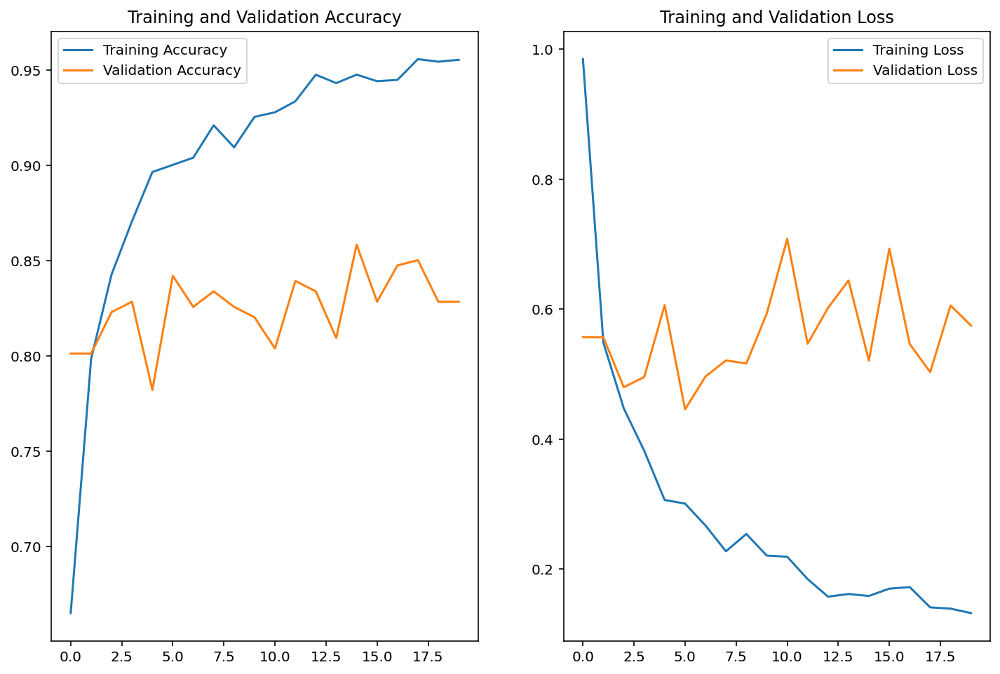

In [136]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(EPOCHS)

plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

In [137]:
# 모델 평가
test_evaluation = model.evaluate(test_batches)

# 테스트 정확도 출력
test_accuracy = test_evaluation[1]
print("Test Accuracy:", test_accuracy)


46/46 [==============================] - 1s 28ms/step - loss: 0.4814 - accuracy: 0.8774
Test Accuracy: 0.8773841857910156


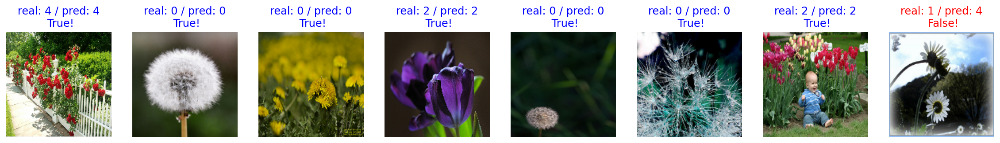

In [138]:
plt.figure(figsize=(20,12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1 ) / 2
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label} / pred: {prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color':'red'})
    else:
        plt.title(title, fontdict={'color':'blue'})
    plt.axis('off')

In [139]:
count = 0
for image, label, prediction in zip(images, labels, predictions):
    correct = label == prediction
    if correct:
        count = count + 1

print(count / 8 * 100) # 약 95% 내외

87.5


accuracy는 좀 떨어졌는데 test accuracy는 더 올랐다.
VGG16는 여기까지 끝내고 다른걸 해보아야겠다.

efficientNetB0로 바꿔서 진행<br>
pre-train 처음 했듯이 모두 freeze 하고 진행

In [143]:
from tensorflow.keras.applications import EfficientNetB0

base_model = EfficientNetB0(weights='imagenet', include_top=False, input_shape=(IMG_SIZE, IMG_SIZE, 3))

# Freeze convolutional base
base_model.trainable = False

# Add custom top layers for new classification task
flatten_layer = Flatten()(base_model.output)
dense_layer_1 = Dense(256, activation='relu')(flatten_layer)
dropout_layer = Dropout(0.5)(dense_layer_1)
output_layer = Dense(5, activation='softmax')(dropout_layer) 
# Create the new model
model = Model(inputs=base_model.input, outputs=output_layer)

# Compile the model
model.compile(optimizer=Adam(lr=0.001), loss=SparseCategoricalCrossentropy(), metrics=['accuracy'])

# Display model summary
model.summary()

16719872/16705208 [==============================] - 0s 0us/step
Model: "model_16"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_18 (InputLayer)           [(None, 160, 160, 3) 0                                            
__________________________________________________________________________________________________
rescaling_1 (Rescaling)         (None, 160, 160, 3)  0           input_18[0][0]                   
__________________________________________________________________________________________________
normalization_1 (Normalization) (None, 160, 160, 3)  7           rescaling_1[0][0]                
__________________________________________________________________________________________________
stem_conv_pad (ZeroPadding2D)   (None, 161, 161, 3)  0           normalization_1[0][0]            
__________________________

In [145]:
EPOCHS = 20
history = model.fit(train_batches,
                   epochs=EPOCHS,
                   validation_data=validation_batches)

Epoch 1/20
367/367 [==============================] - 16s 28ms/step - loss: 2.2798 - accuracy: 0.2377 - val_loss: 1.6019 - val_accuracy: 0.2425
Epoch 2/20
367/367 [==============================] - 9s 23ms/step - loss: 1.6041 - accuracy: 0.2520 - val_loss: 1.5980 - val_accuracy: 0.2425
Epoch 3/20
367/367 [==============================] - 9s 23ms/step - loss: 1.6008 - accuracy: 0.2517 - val_loss: 1.5955 - val_accuracy: 0.2425
Epoch 4/20
367/367 [==============================] - 9s 23ms/step - loss: 1.6063 - accuracy: 0.2517 - val_loss: 1.5947 - val_accuracy: 0.2425
Epoch 5/20
367/367 [==============================] - 9s 23ms/step - loss: 1.6069 - accuracy: 0.2514 - val_loss: 1.5939 - val_accuracy: 0.2425
Epoch 6/20
367/367 [==============================] - 9s 23ms/step - loss: 1.5997 - accuracy: 0.2517 - val_loss: 1.5935 - val_accuracy: 0.2425
Epoch 7/20
367/367 [==============================] - 9s 23ms/step - loss: 1.5998 - accuracy: 0.2517 - val_loss: 1.5935 - val_accuracy: 0.242

In [ ]:
for image_batch, label_batch in test_batches.take(1): #.take 첫 번째 배치를 가져오는 역할
        images = image_batch
        labels = label_batch
        predictions = model.predict(image_batch)
        break
        
predictions

In [ ]:
predictions = np.argmax(predictions, axis=1)
predictions

In [146]:
# 모델 평가
evaluation = model.evaluate(validation_batches)

# 평가 결과 출력
print("Loss:", evaluation[0])
print("Accuracy:", evaluation[1])

46/46 [==============================] - 1s 19ms/step - loss: 1.5935 - accuracy: 0.2425
Loss: 1.593471646308899
Accuracy: 0.24250681698322296


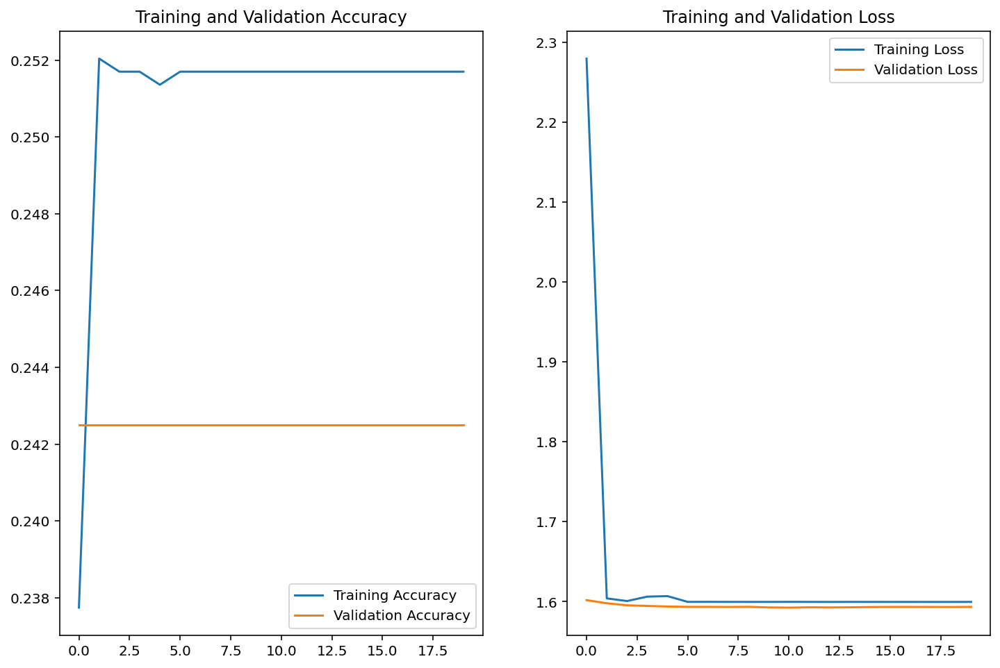

In [147]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(EPOCHS)

plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

In [148]:
# 모델 평가
test_evaluation = model.evaluate(test_batches)

# 테스트 정확도 출력
test_accuracy = test_evaluation[1]
print("Test Accuracy:", test_accuracy)


46/46 [==============================] - 1s 19ms/step - loss: 1.6163 - accuracy: 0.1907
Test Accuracy: 0.19073569774627686


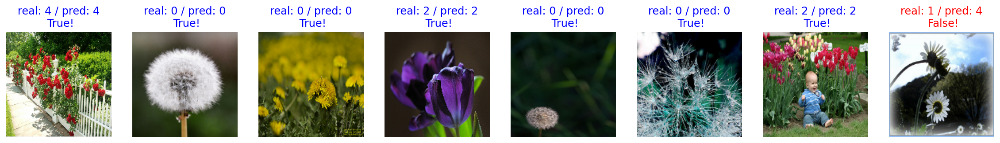

In [149]:
plt.figure(figsize=(20,12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1 ) / 2
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label} / pred: {prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color':'red'})
    else:
        plt.title(title, fontdict={'color':'blue'})
    plt.axis('off')

In [150]:
count = 0
for image, label, prediction in zip(images, labels, predictions):
    correct = label == prediction
    if correct:
        count = count + 1

print(count / 8 * 100) # 약 95% 내외

87.5


acc가 잘 나오지 않았다.
몇몇레이어만 freeze를 해야겠다.

In [144]:
for i, layer in enumerate(base_model.layers):
    print(f"Layer {i}: {layer.name}")

Layer 0: input_18
Layer 1: rescaling_1
Layer 2: normalization_1
Layer 3: stem_conv_pad
Layer 4: stem_conv
Layer 5: stem_bn
Layer 6: stem_activation
Layer 7: block1a_dwconv
Layer 8: block1a_bn
Layer 9: block1a_activation
Layer 10: block1a_se_squeeze
Layer 11: block1a_se_reshape
Layer 12: block1a_se_reduce
Layer 13: block1a_se_expand
Layer 14: block1a_se_excite
Layer 15: block1a_project_conv
Layer 16: block1a_project_bn
Layer 17: block2a_expand_conv
Layer 18: block2a_expand_bn
Layer 19: block2a_expand_activation
Layer 20: block2a_dwconv_pad
Layer 21: block2a_dwconv
Layer 22: block2a_bn
Layer 23: block2a_activation
Layer 24: block2a_se_squeeze
Layer 25: block2a_se_reshape
Layer 26: block2a_se_reduce
Layer 27: block2a_se_expand
Layer 28: block2a_se_excite
Layer 29: block2a_project_conv
Layer 30: block2a_project_bn
Layer 31: block2b_expand_conv
Layer 32: block2b_expand_bn
Layer 33: block2b_expand_activation
Layer 34: block2b_dwconv
Layer 35: block2b_bn
Layer 36: block2b_activation
Layer 37:

In [190]:
for layer in base_model.layers[6:161]:
    print(layer.name)


stem_activation
block1a_dwconv
block1a_bn
block1a_activation
block1a_se_squeeze
block1a_se_reshape
block1a_se_reduce
block1a_se_expand
block1a_se_excite
block1a_project_conv
block1a_project_bn
block2a_expand_conv
block2a_expand_bn
block2a_expand_activation
block2a_dwconv_pad
block2a_dwconv
block2a_bn
block2a_activation
block2a_se_squeeze
block2a_se_reshape
block2a_se_reduce
block2a_se_expand
block2a_se_excite
block2a_project_conv
block2a_project_bn
block2b_expand_conv
block2b_expand_bn
block2b_expand_activation
block2b_dwconv
block2b_bn
block2b_activation
block2b_se_squeeze
block2b_se_reshape
block2b_se_reduce
block2b_se_expand
block2b_se_excite
block2b_project_conv
block2b_project_bn
block2b_drop
block2b_add
block3a_expand_conv
block3a_expand_bn
block3a_expand_activation
block3a_dwconv_pad
block3a_dwconv
block3a_bn
block3a_activation
block3a_se_squeeze
block3a_se_reshape
block3a_se_reduce
block3a_se_expand
block3a_se_excite
block3a_project_conv
block3a_project_bn
block3b_expand_conv
b

In [204]:
from tensorflow.keras.applications import EfficientNetB0

base_model = EfficientNetB0(weights='imagenet', include_top=False, input_shape=(IMG_SIZE, IMG_SIZE, 3))

# Freeze convolutional base
for layer in base_model.layers[46:226]:
    layer.trainable = False

# Add custom top layers for new classification task
flatten_layer = Flatten()(base_model.output)
dense_layer_1 = Dense(256, activation='relu')(flatten_layer)
dropout_layer = Dropout(0.5)(dense_layer_1)
output_layer = Dense(5, activation='softmax')(dropout_layer) 
# Create the new model
model = Model(inputs=base_model.input, outputs=output_layer)

# Compile the model
model.compile(optimizer=Adam(lr=0.001), loss=SparseCategoricalCrossentropy(), metrics=['accuracy'])

# Display model summary
model.summary()

Model: "model_22"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_24 (InputLayer)           [(None, 160, 160, 3) 0                                            
__________________________________________________________________________________________________
rescaling_7 (Rescaling)         (None, 160, 160, 3)  0           input_24[0][0]                   
__________________________________________________________________________________________________
normalization_7 (Normalization) (None, 160, 160, 3)  7           rescaling_7[0][0]                
__________________________________________________________________________________________________
stem_conv_pad (ZeroPadding2D)   (None, 161, 161, 3)  0           normalization_7[0][0]            
___________________________________________________________________________________________

In [205]:
EPOCHS = 20
history = model.fit(train_batches,
                   epochs=EPOCHS,
                   validation_data=validation_batches)

Epoch 1/20
367/367 [==============================] - 31s 66ms/step - loss: 1.2752 - accuracy: 0.6975 - val_loss: 1.9212 - val_accuracy: 0.1090
Epoch 2/20
367/367 [==============================] - 24s 65ms/step - loss: 0.5552 - accuracy: 0.8089 - val_loss: 1.8649 - val_accuracy: 0.2916
Epoch 3/20
367/367 [==============================] - 24s 63ms/step - loss: 0.5142 - accuracy: 0.8307 - val_loss: 1.5888 - val_accuracy: 0.3569
Epoch 4/20
367/367 [==============================] - 24s 63ms/step - loss: 0.5974 - accuracy: 0.8270 - val_loss: 15.9116 - val_accuracy: 0.2752
Epoch 5/20
367/367 [==============================] - 24s 64ms/step - loss: 0.4698 - accuracy: 0.8552 - val_loss: 1.4997 - val_accuracy: 0.3896
Epoch 6/20
367/367 [==============================] - 24s 63ms/step - loss: 0.3764 - accuracy: 0.8777 - val_loss: 1.6375 - val_accuracy: 0.2561
Epoch 7/20
367/367 [==============================] - 24s 63ms/step - loss: 0.3791 - accuracy: 0.8825 - val_loss: 1.9515 - val_accuracy

In [206]:
for image_batch, label_batch in test_batches.take(1): #.take 첫 번째 배치를 가져오는 역할
        images = image_batch
        labels = label_batch
        predictions = model.predict(image_batch)
        break
        
predictions


array([[1.53357849e-01, 2.52175212e-01, 2.51927555e-01, 1.49331689e-01,
        1.93207741e-01],
       [9.99999762e-01, 2.02711874e-07, 2.22378098e-16, 3.45856321e-09,
        7.98538564e-16],
       [8.87521207e-01, 3.80028747e-02, 1.02614460e-03, 7.25285411e-02,
        9.21240775e-04],
       [3.01485449e-01, 2.27221921e-01, 1.58354625e-01, 2.44840547e-01,
        6.80974945e-02],
       [8.66992533e-01, 4.49843556e-02, 1.78048480e-03, 8.52674767e-02,
        9.75137227e-04],
       [9.88534749e-01, 5.67814475e-03, 5.78416666e-06, 5.76830190e-03,
        1.31165352e-05],
       [1.76276878e-01, 2.82585800e-01, 1.79443821e-01, 1.38280258e-01,
        2.23413184e-01],
       [3.07387739e-01, 2.01302320e-01, 1.42586097e-01, 2.47668430e-01,
        1.01055406e-01]], dtype=float32)

In [207]:
predictions = np.argmax(predictions, axis=1)
predictions

array([1, 0, 0, 0, 0, 0, 1, 0])

In [208]:
# 모델 평가
evaluation = model.evaluate(validation_batches)

# 평가 결과 출력
print("Loss:", evaluation[0])
print("Accuracy:", evaluation[1])

46/46 [==============================] - 1s 21ms/step - loss: 1.7821 - accuracy: 0.4332
Loss: 1.7821331024169922
Accuracy: 0.4332424998283386


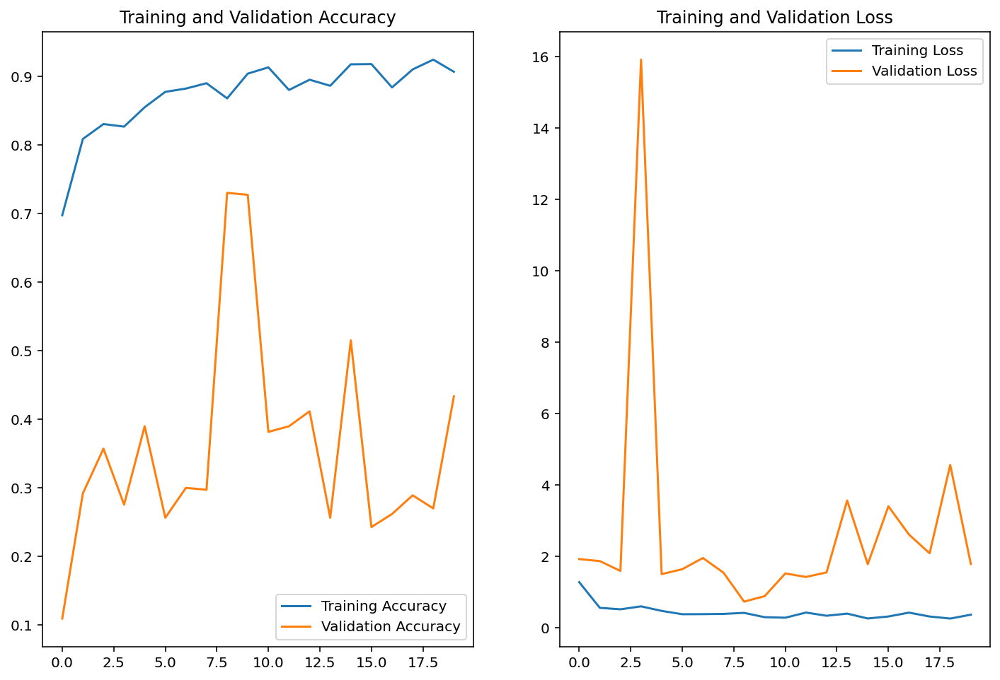

In [209]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(EPOCHS)

plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

In [210]:
# 모델 평가
test_evaluation = model.evaluate(test_batches)

# 테스트 정확도 출력
test_accuracy = test_evaluation[1]
print("Test Accuracy:", test_accuracy)


46/46 [==============================] - 1s 19ms/step - loss: 1.8620 - accuracy: 0.3924
Test Accuracy: 0.3923705816268921


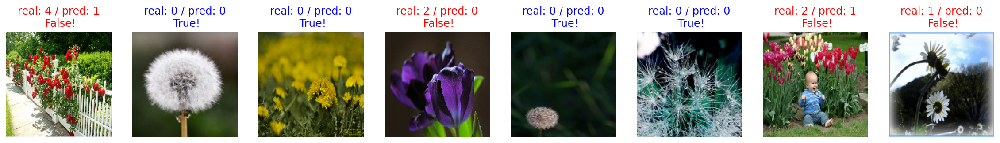

In [211]:
plt.figure(figsize=(20,12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1 ) / 2
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label} / pred: {prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color':'red'})
    else:
        plt.title(title, fontdict={'color':'blue'})
    plt.axis('off')

In [212]:
count = 0
for image, label, prediction in zip(images, labels, predictions):
    correct = label == prediction
    if correct:
        count = count + 1

print(count / 8 * 100) # 약 95% 내외

50.0


In [177]:
from sklearn.metrics import classification_report

predictions = model.predict(test_batches)


labels = []
for _, label in test:
    labels.append(label.numpy())
np.array(labels)


class_names = metadata.features['label'].names


print(classification_report(labels, np.argmax(predictions, axis=-1), target_names=class_names))

              precision    recall  f1-score   support

   dandelion       0.44      0.71      0.55        70
       daisy       0.35      0.59      0.44        61
      tulips       0.44      0.71      0.55        85
  sunflowers       0.14      0.03      0.04        76
       roses       0.50      0.01      0.03        75

    accuracy                           0.41       367
   macro avg       0.38      0.41      0.32       367
weighted avg       0.38      0.41      0.32       367



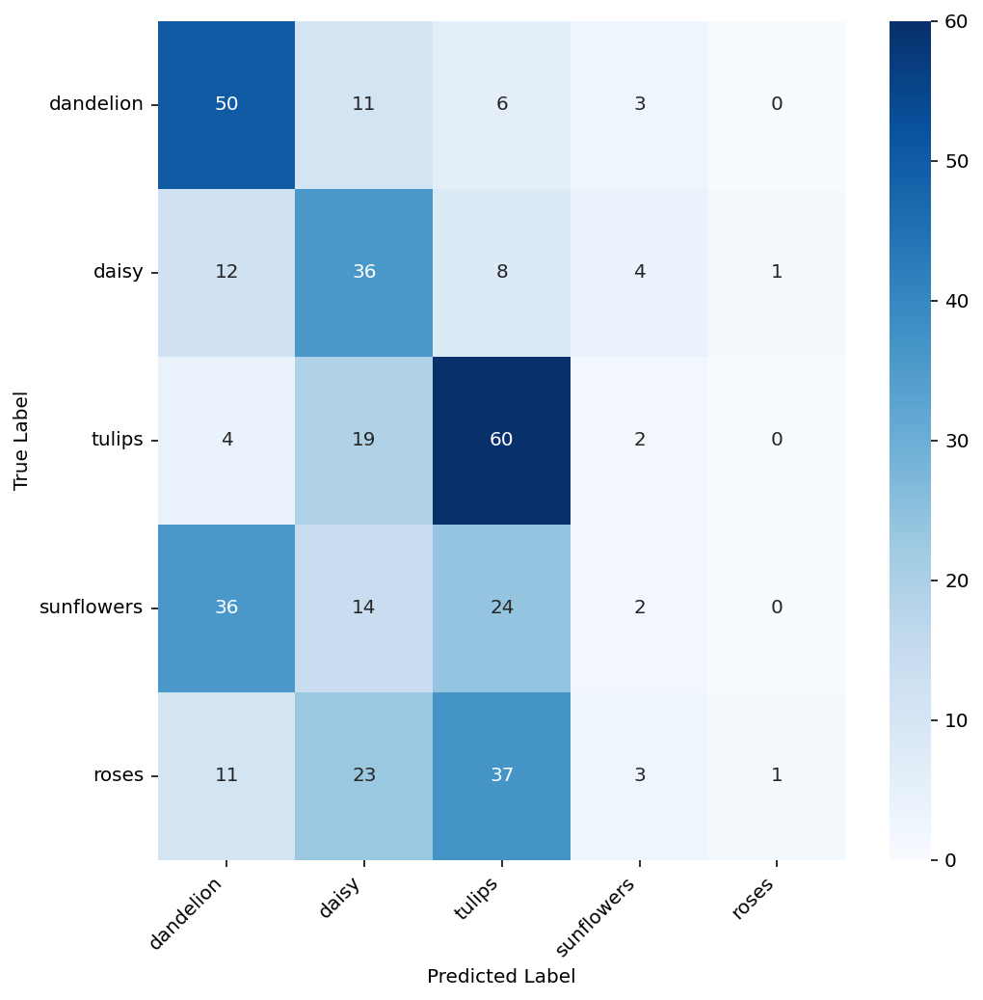

In [178]:
import seaborn as sns
from sklearn.metrics import confusion_matrix

plt.figure(figsize=(8, 8))
cm2 = confusion_matrix(labels, np.argmax(predictions, axis=-1))
sns.heatmap(cm2, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.xticks(ticks=np.arange(0.5, 5.5), labels=class_names, rotation=45, ha='right')
plt.yticks(ticks=np.arange(0.5, 5.5), labels=class_names, rotation=0)
plt.show()

EfficientNET 부분적으로 freeze 했을 때 조금 더 나은 결과를 볼 수있었다.<br>
freeze 할 부분을 하고 레이어를 조금 손을 보면 향상이 될 것 같다.<br>
일단은 EfficientNT은 여기서 멈추도록 해야겟다.

## 모델 불러오기

In [232]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array

In [239]:
checkpoint_dir

'/aiffel/aiffel/aiffel_quest/quest_240318/data/checkpoint'

In [252]:
from tensorflow.keras import models

vgg16_model = models.load_model('/aiffel/aiffel/aiffel_quest/quest_240318/data/checkpoint/checkpoint.h5')
vgg16_model

In [253]:
# 모델 성능 확인
vgg16_model.evaluate(test_batches)

46/46 [==============================] - 2s 30ms/step - loss: 0.8515 - accuracy: 0.8447


[0.8515424728393555, 0.8446866273880005]

In [256]:
img_dir_path = os.getenv("HOME") + "/aiffel/aiffel_quest/quest_240318/data"

In [278]:
def show_and_predict_image(dirpath, filename, img_size=160):
    filepath=os.path.join(dirpath, filename)
    image = load_img(filepath, target_size=(img_size, img_size))
    plt.imshow(image)
    plt.axis('off')
    image = img_to_array(image).reshape(1, img_size, img_size, 3)
    prediction = vgg16_model.predict(image)
    pred_index = np.argmax(prediction)
    pred_label = class_names[pred_index]
    print(f"This image seems {pred_label} with a prob {np.max(prediction)}")

This image seems daisy with a prob 1.0


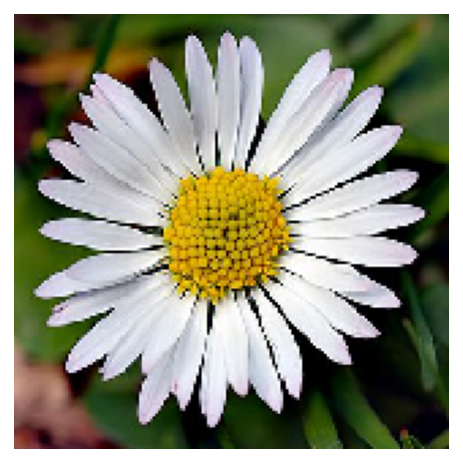

In [279]:
filename = 'daisy.jpg'

show_and_predict_image(img_dir_path, filename)

This image seems dandelion with a prob 1.0


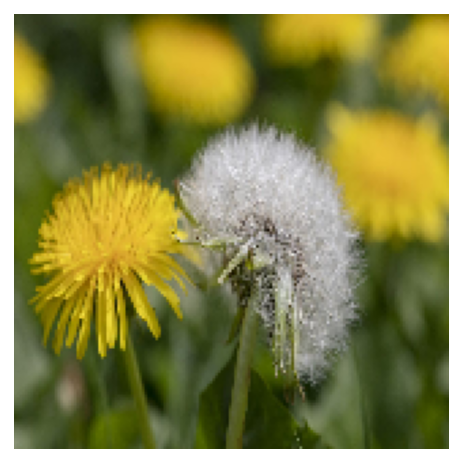

In [280]:
filename = 'dandelion.jpg'

show_and_predict_image(img_dir_path, filename)

This image seems roses with a prob 1.0


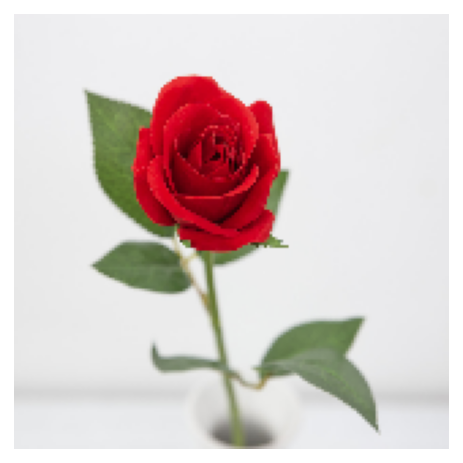

In [281]:
filename = 'roses.jpg'

show_and_predict_image(img_dir_path, filename)

This image seems sunflowers with a prob 1.0


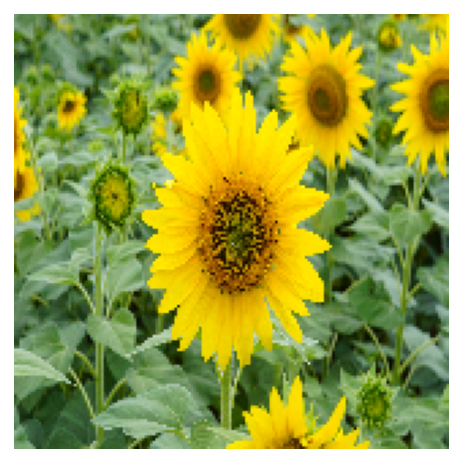

In [282]:
filename = 'sunflower.jpg'

show_and_predict_image(img_dir_path, filename)

This image seems tulips with a prob 1.0


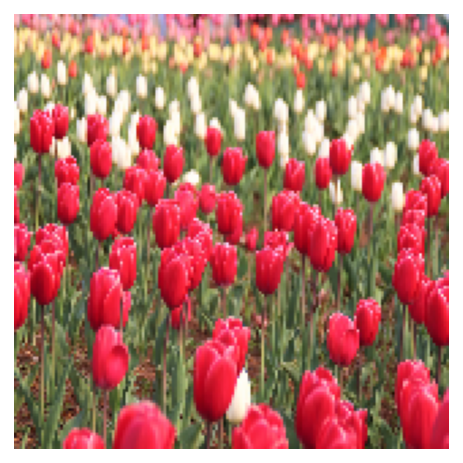

In [283]:
filename = 'tulip.jpeg'

show_and_predict_image(img_dir_path, filename)

This image seems tulips with a prob 1.0


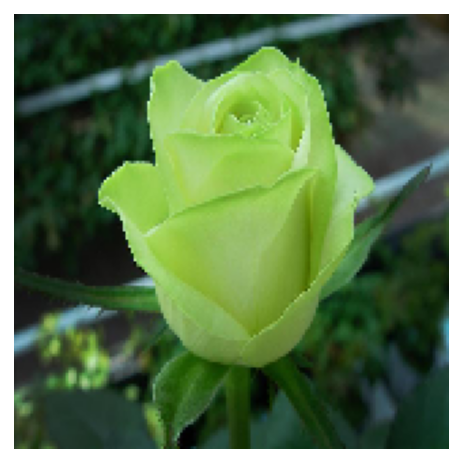

In [284]:
filename = 'roses2.jpg'

show_and_predict_image(img_dir_path, filename)

This image seems roses with a prob 1.0


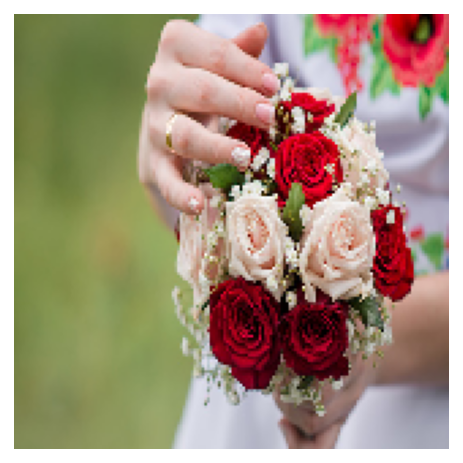

In [285]:
filename = 'roses3.jpg'

show_and_predict_image(img_dir_path, filename)

vgg16 에서 잘 예측이 안됀 클래스도 있었는데 잘 나와서 놀랍다

## 회고

accuracy: 0.8610
Test Accuracy: 0.8610354065895081


accuracy: 0.8774
Test Accuracy: 0.8773841857910156

VGG16으로 87까지 이뤄내는데 pre-train에 중요성을 깨달았다.
0.01을 올릴 때도 전체를 freeze 하느냐 freeze 를 어디를 하느냐에 따라서
차이가 발생했다.

다른 모델로도 한번 시도를 해보았는데. 최적화를 하기가 너무 힘이들었다.
모델도 복잡하고 층이 많다보니 시간적으로 오래 걸리기도 하여 원하는 만큼의
성능에 도달하진 못했다. 다른 모델로도 확인을 한 것만으로도 만족한다.
